# Faster-RCNN for Dog and Cat Recognition

* **AUTHOR**: Luis Retana
* **COURSE**: Deep Learning for Computer Vision, Winter 2025

---
## 0) Objectives
Goal is to learn the following:
1. Learn how to use transfer learning with existing PyTorch models
2. Learn how to "freeze" model weights and customize certain parts of the model
3. Understand how to alter the data if needed to work with pretrained model
4. Build upon previous image classification assignment by performing object detection

---
## 1) Data Exploration

### Ofxord IIIT Pet Dataset - What Is It?

Dataset annotating images of various dog and cat species for object recognition and object segmentation purposes

### Links
- PyTorch Dataset: https://pytorch.org/vision/stable/generated/torchvision.datasets.OxfordIIITPet.html#torchvision.datasets.OxfordIIITPet
- Official Site - https://www.robots.ox.ac.uk/~vgg/data/pets/

### Shape
**Input**
- Total Images: 50,000+
- Size: Varies (no resize needed for Faster RCNN))

**Output**
- Classes: 37 species (dog species + cat species), 2 binary (cat or dog)
    * According to TensorFlow (https://www.tensorflow.org/datasets/catalog/oxford_iiit_pet) 0 maps to cat and 1 maps to dog for `species` label.


#### Classification Labels
~~There are 42 classification labels. See the array below for the mappings from [0, 42]~~

We add a background at 0 index as expected by the Faster RCNN prebuilt model. Therefore our labels will be shifted by one when compared to the origina, raw datasets labels [0, 36] they will be [0, 37]

We will need to create custom target transform for the GTRSB dataset to transform its labels to start at 1 instead of 0 to make 0 available for thte background by the model.

In [ ]:
classes = [
    '--background--',               # 0
    'abyssinian',                   # 1
    'american_bulldog',             # 2
    'american_pit_bull_terrier',    # 3
    'basset_hound',                 # 4
    'beagle',                       # 5
    'bengal',
    'birman',
    'bombay',
    'boxer',
    'british_shorthair',            # 10
    'chihuahua',
    'egyptian_mau',
    'english_cocker_spaniel',
    'english_setter',
    'german_shorthaired',           # 15
    'great_pyrenees',
    'havanese',
    'japanese_chin',
    'keeshond',
    'leonberger',                   # 20
    'maine_coon',
    'miniature_pinscher',
    'newfoundland',
    'persian',
    'pomeranian',                   # 25
    'pug',
    'ragdoll',
    'russian_blue',
    'saint_bernard',
    'samoyed',                      # 30
    'scottish_terrier',
    'shiba_inu',
    'siamese',
    'sphynx',
    'staffordshire_bull_terrier',   # 35
    'wheaten_terrier',
    'yorkshire_terrier'             # 37
]
# list lookup for label name -> label value
label_to_labelname = classes
# dictionary lookup table for label value ->
labelnames_to_label = { c: classes.index(c) for c in classes}
labelnames_to_label['pug']


26

---
## 2) Data Acquisition and Augmentation

### Import Packages Needed

In [ ]:
# Load in the necessary libraries
# !pip install matplotlib
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import torchvision.transforms as transforms
import torchvision.datasets as datasets

import matplotlib.pyplot as plt
import numpy as np

import os
import copy
import random
import time
import math

%matplotlib inline


SEED = 9999
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True

### Load Data

Downloading may take a minute. We load in the training and test data using a custom dataset made (due to pytorch version of dataset missing the expected bounding box annotations/output for its test split), split the training data into a training and validation set, then create Samplers and DataLoaders for each of these sets of data.

Althought not pictured in thise notebook, we know that the the testing data (from pytorch native Oxford IIIT dataset) is incomplete. It is missing annotations (specifically bounding box information) for its "test" split dataset. Therefore we will need to construct a custom dataset that wraps the pytorch Oxford IIIT dataset in order to provide us with a subset of the original so that our new training, validation, and testing data all have full annotation (bounding box and label) data.

We will take "trainval" split from the pytorch Oxford IIIT dataset for our model and will split this data into training, validation, and testing data for our code to operate on.


#### Custom Dataset

In [ ]:

import xml.etree.ElementTree as ET  # needed to extract bound box info from xml annotation files
from PIL import Image               # needed to process jpg files into images

# PURPOSE: To build on top of PyTorch Oxford IIIT dataset by
# adding support for bound box target data for each image in the dataset
# in addition to its classification label
#
#
# common to use the color mean and std from imagenet pretrained net as it
# is trained on millions of images
MEAN = [0.485, 0.456, 0.406]
STD = [0.229, 0.224, 0.225]
transform = transforms.Compose([
    #transforms.Resize((IMAGE_WIDTH, IMAGE_HEIGHT)),         # we want to ensure all input images are transformed into consistent size
    transforms.ToTensor(),
    # transforms.ColorJitter(brightness=0.5, contrast=1, saturation=0.1, hue=0.5),
    transforms.Normalize(mean=MEAN, std=STD)  # we have 3 channels since its a color image
])

# Define Custom loader since out-of-the-box DataLoader provided by PyTorch
# this dataset simply returns scalar labels (values 0-35 for the dog and cat
# classes). For object recognition we also need the bounding box targets, so we
# will define our own custom dataloader
# Based on source code of original oxford_iii_pet dataset - https://pytorch.org/vision/main/_modules/torchvision/datasets/oxford_iiit_pet.html
class AugmentedOxfordIIITPetDataset(torch.utils.data.Dataset):
    def __init__(self, transform=None):
        """
        Input
        * transform - pytorch transforms to be applied to feature data (i.e., the feature image)
        """
        self._DATA_DOWNLOAD_PATH = './data'
        self._ROOT_PATH = f'{self._DATA_DOWNLOAD_PATH}/oxford-iiit-pet'
        self._SPLIT = "trainval"
        self._transform = transform

        # Due to this Oxford IIIIT Pet dataset missing annotations for all test split data, we will
        # derive our dataset (train, validation, and test) from the original dataset's "trainval" split
        self._raw_dataset = datasets.OxfordIIITPet(self._DATA_DOWNLOAD_PATH,
                                    split = self._SPLIT,
                                    target_types = 'category',
                                    download = True)

        # Filter out the datum with missing annotations
        self._filtered_dataset = self._build_dataset()

        #
        # Gather all the info __get_item__() will need to pull in the data (image, bound box,
        # and label) for each record
        #
        # 1 - Get Images file paths
        self._images_folder_path = f'{self._ROOT_PATH}/images'
        self._image_files = [ (f'{self._images_folder_path}/{file}.jpg') for file in self._filtered_dataset]
        print(self._image_files[:5])

        # 2 - Get Output Classification Bound Box
        self._annotation_xml_folder_path = f'{self._ROOT_PATH}/annotations/xmls'
        self._annotation_xml_files = [ (f'{self._annotation_xml_folder_path}/{file}.xml') for file in self._filtered_dataset]
        print(self._annotation_xml_files[:5])

        # 3 - Get Output Labels (this is inferred by filename structure "species_100.xml")
        self._label_names = [ (file[:file.rfind('_')].lower()) for file in self._filtered_dataset]
        self._labels = [ labelnames_to_label[name] for name in self._label_names]
        print(self._labels[:5])

    def __len__(self) -> int:
        """
        Returns the number of items in the dataset
        """
        return len(self._filtered_dataset)

    def __getitem__(self, idx) -> tuple:
        """
        Gets the specified item from the item

        INPUT
        * idx (int) -> index of the item to fetch (zero-based)

        RETURNS
        * tuple with the following properties in order
            * [0] = data
                * [0] = image
                * [1] = image file
            * [1] = annotations
                * [0] = label
                * [1] = bound box
                * [2] = label name
        """

        # Get the image data and apply any specified transforms onto it
        image_file = self._image_files[idx]
        image = Image.open(image_file).convert("RGB")

        if self._transform:
            image = self._transform(image)

        # Get bound box info
        annotation_file = self._annotation_xml_files[idx]
        bbox = self._get_bbox_from_annotation(annotation_file)

        # Get classification label info
        label = self._labels[idx]
        labelname = self._label_names[idx]

        data = (image, image_file)
        annotations = (label, bbox, labelname)

        return data, annotations

    #
    # Helper Functions
    #
    def _build_dataset(self):
        """
        Will filter out dirty data from our dataset
        """
        data = []
        # get list of all potential data
        original_trainval_files = self._parse_split_file(self._SPLIT)
        #print(f'Found ({len(original_trainval_files)}) trainval files...')
        available_annotation_files = self._get_annotation_xml_files()
        #print(f'Found ({len(available_annotation_files)}) xml annotation files...')
        # these represent the files that have all the data we need (images, and output label and bounding boxes aka annotations)
        dataset_files = [f for f in original_trainval_files if f in available_annotation_files]
        print(f'--> We have ({len(dataset_files)}) number of complete data in our final dataset')
        return dataset_files

    def _get_bbox_from_annotation(self, annotation_xml_path):
        """
        Get bound box coordinates from the specified annotation xml file

        INPUT
        * annotation_xml_path (str) - relative path to the annotation xml file to process

        OUTPUT
        * list of int   - list holding coordinates of bounding box
            * [0] = xmin
            * [1] = ymin
            * [2] = xmax
            * [3] = ymax
        """
        tree = ET.parse(annotation_xml_path)
        annotation = tree.getroot()
        xmin = int(annotation.find('./object/bndbox/xmin').text)
        ymin = int(annotation.find('./object/bndbox/ymin').text)
        xmax = int(annotation.find('./object/bndbox/xmax').text)
        ymax = int(annotation.find('./object/bndbox/ymax').text)
        return [xmin, ymin, xmax, ymax]

    def _parse_split_file(self, split) -> list:
        """
        Extracts the first token from each line of a file.

        Args:
            split (str): The split being used in the dataset

        Returns:
            list: A list of filenames specified in the dataset annotation txt files
        """
        if split not in ["trainval", "test"]:
            raise ValueError('split must be either "trainval" | "test"')

        filenames = []
        try:
            with open(f'./data/oxford-iiit-pet/annotations/{split}.txt', 'r') as file:
                for line in file:
                    line = line.strip()  # Remove leading/trailing whitespace
                    if line:  # Ensure line is not empty
                        tokens = line.split()
                        filenames.append(tokens[0])
        except FileNotFoundError:
            print(f"Error: File not found: {file_path}")
        return filenames

    def _get_annotation_xml_files(self):
        """
        Retrieves the list of annotation xml filenames with the file extension omitted

        Args:
            none

        Returns:
            list: A list of annotation file names with file extension omitted
        """
        folder_path = './data/oxford-iiit-pet/annotations/xmls'
        # get the filename without the extension
        files =  [f[:-4] for f in os.listdir(folder_path)]
        files.sort()
        return files

    #
    # Custom Transform needed to ensure that the native labels
    # from the GTSRB dataset start at 1 so that 0 is used to represent background
    #
    def _transform_shift_labels(label):
        return label + 1

#### Load Custom Dataset and Define DataLoaders

In [ ]:
# from torchvision import datasets
# import torchvision.transforms as transforms
from torch.utils.data.sampler import SubsetRandomSampler
from sklearn.model_selection import train_test_split

# number of subprocesses to use for data loading
NUM_WORKERS = 0
# how many samples per batch to load
BATCH_SIZE = 10
# percentage of training set to use as validation
TRAIN_RATIO = 0.8
VALIDATION_RATIO = 0.1       # Percent of
# TEST_RATIO not needed as it will simply take the remaining data


# convert data to a normalized torch.FloatTensor
# ToTensor()    - converts images to tensors with shape [Channel x Rows X Columns]
#                 and values [0.0, 1.0]
# Normalize()   - converts images then to be [-1.0, 1.0] since we use a mean of
#                 0.5 and std of 0.5 for each of the 3 channels:
#                     output[channel] = (input[channel] - MEAN) / STD
#
transform = transforms.Compose([
    #transforms.Resize((IMAGE_WIDTH, IMAGE_HEIGHT)),         # we want to ensure all input images are transformed into consistent size
    transforms.ToTensor(),
    # transforms.ColorJitter(brightness=0.5, contrast=1, saturation=0.1, hue=0.5),
    transforms.Normalize(mean=MEAN, std=STD)  # we have 3 channels since its a color image
])

# Get dataset and print out sample data for sanity check
DATA = AugmentedOxfordIIITPetDataset(transform=transform)
# sanity checks
# get list of training images that actually have annotation files
features = DATA._parse_split_file("trainval")
xml_files = DATA._get_annotation_xml_files()
filtered_images = [f for f in features if f in xml_files]
print(f'\nTotal Training Data : {len(features)}')
print(f'Total Annotations : {len(xml_files)}')
print(f'How Many Training Data Have Annotation: {len(filtered_images)}')

features = DATA._parse_split_file("test")
filtered_images = [f for f in features if f in xml_files]
print(f'\nTotal Testing Data : {len(features)}')
print(f'Total Annotations : {len(xml_files)}')
print(f'How Many Testing Data Have Annotation: {len(filtered_images)}')

features, labels = DATA.__getitem__(0)
print(f'\nImage Filename: {features[1]}')
print(f'- Label: {labels[0]}')
print(f'- Label Name: {labels[2]}')
print(f'- Bounding Box: {labels[1]}')

# Create training, validatio, and testing data partitions
TOTAL_DATA_SIZE = len(DATA)
TRAIN_SIZE = int(np.floor(TRAIN_RATIO * len(DATA)))
VALIDATION_SIZE = int(np.floor(VALIDATION_RATIO * len(DATA)))
TEST_SIZE = len(DATA) - TRAIN_SIZE - VALIDATION_SIZE
print(f'\nCreating training, validation, and test datasets...')
print(f'Total Data size: {len(DATA)}')
print(f'Train Size: {TRAIN_SIZE}')
print(f'Validation Size: {VALIDATION_SIZE}')
print(f'Testing Size: {TEST_SIZE}')

# obtain training indices for all of the data and shuffle them
indices = list(range(TOTAL_DATA_SIZE))
np.random.shuffle(indices)

# now split the shuffled indices according to the training, validation, and testing data sizes we computed above
print(f'\nCreating training, validation, and test indices...')
train_idx, valid_idx, test_idx = indices[:TRAIN_SIZE], indices[TRAIN_SIZE:TRAIN_SIZE + VALIDATION_SIZE], indices[TRAIN_SIZE + VALIDATION_SIZE:]
print(f'Total Data size: {TOTAL_DATA_SIZE}')
print(f'Train Size: {len(train_idx)}')
print(f'Validation Size: {len(valid_idx)}')
print(f'Testing Size: {len(test_idx)}')

# define samplers for obtaining training and validation batches
train_sampler = SubsetRandomSampler(train_idx)
valid_sampler = SubsetRandomSampler(valid_idx)
test_sampler = SubsetRandomSampler(test_idx)

# Custom collate function is needed because we are handling different sized images (faster rcnn supports
# input images of different sizes) and this prevents the native data loader implementation from
# attempting to store the mixed dimension data (images) into a fixed size tensor which would throw errors
def custom_collate_fn(batch):
    images = [item[0] for item in batch]
    targets = [item[1] for item in batch]
    return images, targets

# prepare data loaders (combine dataset and sampler)
# dataloaders   - help efficiently load data in batches from the
#                 large datasets in parallel using workers
# samplers      - they determine how batches are formed (sequential, random, weighted, etc.)

print('Creating data samplers...')
train_loader = torch.utils.data.DataLoader(DATA, batch_size=BATCH_SIZE,
    sampler=train_sampler, num_workers=NUM_WORKERS, collate_fn=custom_collate_fn)
valid_loader = torch.utils.data.DataLoader(DATA, batch_size=BATCH_SIZE,
    sampler=valid_sampler, num_workers=NUM_WORKERS, collate_fn=custom_collate_fn)
test_loader = torch.utils.data.DataLoader(DATA, batch_size=BATCH_SIZE,
    sampler=test_sampler, num_workers=NUM_WORKERS, collate_fn=custom_collate_fn)

print('\nDone')

--> We have (3671) number of complete data in our final dataset
['./data/oxford-iiit-pet/images/Abyssinian_100.jpg', './data/oxford-iiit-pet/images/Abyssinian_101.jpg', './data/oxford-iiit-pet/images/Abyssinian_102.jpg', './data/oxford-iiit-pet/images/Abyssinian_103.jpg', './data/oxford-iiit-pet/images/Abyssinian_105.jpg']
['./data/oxford-iiit-pet/annotations/xmls/Abyssinian_100.xml', './data/oxford-iiit-pet/annotations/xmls/Abyssinian_101.xml', './data/oxford-iiit-pet/annotations/xmls/Abyssinian_102.xml', './data/oxford-iiit-pet/annotations/xmls/Abyssinian_103.xml', './data/oxford-iiit-pet/annotations/xmls/Abyssinian_105.xml']
[1, 1, 1, 1, 1]

Total Training Data : 3680
Total Annotations : 3686
How Many Training Data Have Annotation: 3671

Total Testing Data : 3669
Total Annotations : 3686
How Many Testing Data Have Annotation: 0

Image Filename: ./data/oxford-iiit-pet/images/Abyssinian_100.jpg
- Label: 1
- Label Name: abyssinian
- Bounding Box: [151, 71, 335, 267]

Creating training,

In [ ]:
batch = next(iter(train_loader))

features, labels = batch
# features is NOT a tensor but a List of Tensors (since
# we need to support images of differing sizes we dodge an error by having
# the data loader have a custom collation function to direct it to store the
# data into lists and not fixed shape tensors)
print(features)
print(labels)

[(tensor([[[-0.3541, -0.4054, -0.4739,  ...,  0.3823,  0.3994,  0.4166],
         [-0.3712, -0.4226, -0.4739,  ...,  0.3823,  0.3994,  0.4166],
         [-0.3883, -0.4397, -0.4911,  ...,  0.3823,  0.3994,  0.4166],
         ...,
         [ 0.4679,  0.3309,  0.2624,  ..., -0.5253, -0.5253, -0.5253],
         [ 0.4679,  0.4851,  0.4166,  ..., -0.5253, -0.5253, -0.5253],
         [ 0.4508,  0.5878,  0.5707,  ..., -0.5082, -0.5082, -0.5082]],

        [[-0.8102, -0.8627, -0.9328,  ...,  0.2752,  0.2927,  0.3102],
         [-0.8277, -0.8803, -0.9328,  ...,  0.2752,  0.2927,  0.3102],
         [-0.8452, -0.8978, -0.9503,  ...,  0.2752,  0.2927,  0.3102],
         ...,
         [ 0.1527,  0.0651,  0.0126,  ..., -0.6702, -0.6702, -0.6702],
         [ 0.1352,  0.1702,  0.1527,  ..., -0.6702, -0.6702, -0.6702],
         [ 0.1176,  0.2752,  0.2577,  ..., -0.6527, -0.6527, -0.6527]],

        [[-1.1596, -1.2119, -1.2816,  ...,  0.3393,  0.3568,  0.3742],
         [-1.1770, -1.2293, -1.2816,  ..., 

### **Inspect Images**
Here, we look at the normalized red, green, and blue (RGB) color channels as three separate, grayscale intensity images.

[{'labels': tensor(24), 'boxes': tensor([224., 210., 340., 319.])}, {'labels': tensor(18), 'boxes': tensor([129.,  37., 266., 145.])}, {'labels': tensor(15), 'boxes': tensor([299.,  79., 476., 200.])}, {'labels': tensor(6), 'boxes': tensor([204., 145., 286., 231.])}, {'labels': tensor(11), 'boxes': tensor([ 12.,  12., 185., 158.])}, {'labels': tensor(19), 'boxes': tensor([203.,   8., 443., 243.])}, {'labels': tensor(9), 'boxes': tensor([ 61.,  99., 357., 440.])}, {'labels': tensor(21), 'boxes': tensor([165.,  31., 356., 235.])}, {'labels': tensor(15), 'boxes': tensor([ 52.,  83., 203., 181.])}, {'labels': tensor(9), 'boxes': tensor([176., 107., 276., 241.])}]


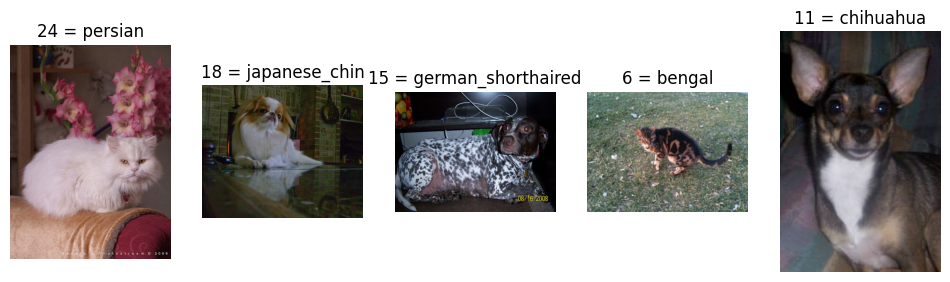

In [ ]:
dataiter = iter(test_loader)

# each iteration of the data loader returns a BATCH of features and annotations
features, annotations = next(dataiter)

# extract images from feature tuples in the features batch
images = [f[0] for f in features]
# extract annotations (labels) from the annotation tuples in the annotations batch
labels = [a[0] for a in annotations]
targets = [{'labels': torch.tensor(a[0], dtype=torch.int64), 'boxes': torch.tensor(a[1], dtype=torch.float32) } for a in annotations]
print(targets)


# Transpose the tensor: (C, H, W) => (H, W, C)
#image_for_plotting = images[0].permute(1, 2, 0)

# Recall as part of the data loader transforms we
def unnormalize(tensor, mean=MEAN, std=STD):
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)
    return tensor

def createPlottableImage(imageToPlot):
    # Convert to NumPy array
    # imageClone = unnormalizedImage.clone()
    # Clip values to the range [0, 1]
    imageToPlot = torch.clamp(imageToPlot, 0, 1)
    # Transpose the dimensions for plotting (C, H, W) -> (H, W, C)
    imageToPlot = imageToPlot.permute(1, 2, 0)
    # Convert to numpy array for plotting
    imageToPlot = imageToPlot.cpu().numpy()
    return imageToPlot

# Display a sample set of 4 images from dataset
fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(12, 9))
for i in range(5):
    ax = axes[i]
    img = images[i].clone()
    ax.imshow(createPlottableImage(unnormalize(img)))
    ax.axis('off')
    ax.set_title(f"{labels[i]} = {label_to_labelname[labels[i]]}")
plt.show()

---
## 3) Build Model

### Model Architecture

Utilize [Faster-RCNN model provided by PyTorch library](https://pytorch.org/vision/stable/models/generated/torchvision.models.detection.fasterrcnn_resnet50_fpn.html#fasterrcnn-resnet50-fpn). We will modify this by updating its final RCNN architecture to fit our data since our data has different structure from the original data this architecture was built for (e.g., we have `38`  classes and not the `90+` original used by the original model)

![Faster RCNN Architecture Overview](https://www.lablab.top/post/how-does-faster-r-cnn-work-part-i/architecture.jpg)

Source: https://www.lablab.top/post/how-does-faster-r-cnn-work-part-i/

The image above depicts Faster-RCNN with a `VGG16` backbone. The model we will be using uses `ResNet50` as its backbone but this figure is used to help depict the final R-CNN layers which we will modify in the following sections.

#### Model Changes Needed
1. Adjust final RCNN layers to fit our data
    * **Why?** - We need to modify the output shape (output 90+ classes) of this pre-trained model architecture to fit with the shape of our data's output (38 classes)
    * **How?** - Create a new RCNN to replace the existing pre-trained model's RCNN (depicted at the tail end of the figure above). Create `FasterRCNNPredictor` from pytorch that takes in the previous layer's output as input, and then outputs data for our number of classes aka `38`


In [ ]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

# Get model we are transfer learning with
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
print(model)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

Take note at the final layers of this `fasterrcnn_resenet50_fpn`:

```text
(roi_heads): RoIHeads(
    (box_roi_pool): MultiScaleRoIAlign(featmap_names=['0', '1', '2', '3'], output_size=(7, 7), sampling_ratio=2)
    (box_head): TwoMLPHead(
      (fc6): Linear(in_features=12544, out_features=1024, bias=True)
      (fc7): Linear(in_features=1024, out_features=1024, bias=True)
    )
    (box_predictor): FastRCNNPredictor(
      (cls_score): Linear(in_features=1024, out_features=91, bias=True)
      (bbox_pred): Linear(in_features=1024, out_features=364, bias=True)
    )
  )
```

Inspecting the final `box_predictor` layers we see there are 2 heads:
1. `cls_score` - input (i.e., `in_features`) is of size `1024`, output (i.e., `out_features`) is of size `91`
2. `bbox_pred` - input (i.e., `in_features`) s of size `1024`, output (i.e., `out_features`) is of size `364` (aka `4 * 91` --> `4` bound box coordinates for each of the `91` classes)

We need to replace this instance off `box_predictor` with our own implementation that will have the following configuration:
* `in_features` = 1024 (the same as before)
* `out_features` = 38 (updated to reflect the number of classes/labels in our dataset)

**NOTE**: Since we wish to reuse the weights from the pretrained model as much as possible (for reason including, harnessing its proven weights that have been computed from large training sets in research, and avoiding spending too much time training this deep RCNN), we will "freeze" the models weights so that our training process does not update them in the backpropagation phases. We do this before we replace the `roi_heads.box_predictor` with our custom one so that our custom predictor's weight are not frozen (and thus, will have its weights updated in training)

In [ ]:

from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

# We only are modifying the final output layer of the model and wish to not edit the weights in the
# model's preceeding layers (1. its saves us training time, 2. we want to harness the robust and accuracy
# of the model that was train to win competitions)
# Freeze all layers
# for param in model.parameters():
#     param.requires_grad = False

# Replace FasterRCNN classifier with a custom one since we need to update it output
# our desired number of classes (+1 for the background aka label 0)
NUM_CLASSES = len(labelnames_to_label)  # background + classes (our labelnames_to_label already accounts for background class)
# record the input size to the existing box_predictor we are going to replace with our custom one
in_features = model.roi_heads.box_predictor.cls_score.in_features
# create the ne predictor that takes (in_features) and maps to to (NUM_CLASSES)
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, NUM_CLASSES)

LEARNING_RATE = 0.01
MOMENTUM = 0.9
WEIGHT_DECAY=0.0005
NUM_EPOCHS = 20
LR_SCHEDULER_STEP_SIZE = 20
LR_SCHEDULER_GAMMA = 0.1
optimizer = torch.optim.SGD(model.parameters(), lr=LEARNING_RATE, momentum=MOMENTUM, weight_decay=WEIGHT_DECAY)
# Learning rate scheduler (from: https://medium.com/@RobuRishabh/understanding-and-implementing-faster-r-cnn-248f7b25ff96)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                               step_size=LR_SCHEDULER_STEP_SIZE,
                                               gamma=LR_SCHEDULER_GAMMA)

# Lets create an early stopper to prevent us from continuing to burn epochs training
# cucles when we are no longer making progresss
class EarlyStopping:
    def __init__(self, patience=5, delta=0):
        self.patience = patience
        self.delta = delta
        self.best_loss = None
        self.no_improvement_count = 0
        self.stop_training = False

    def update_loss(self, val_loss):
        if self.best_loss is None or val_loss < self.best_loss - self.delta:
            self.best_loss = val_loss
            self.no_improvement_count = 0
        else:
            self.no_improvement_count += 1
            if self.no_improvement_count >= self.patience:
                self.stop_training = True

# Create an instance of early stopper to be used in training later
EARLY_STOPPER_PATIENCE = 5
EARLY_STOPPER_DELTA = 0.001
early_stopper = EarlyStopping(patience=EARLY_STOPPER_PATIENCE, delta=EARLY_STOPPER_DELTA)
# print(model)

Taking a look at the updated model architecutre, we see that we successfully replaced the box_predictor with our own custom one with the desired output size:

```text
(roi_heads): RoIHeads(
    ...
    (box_predictor): FastRCNNPredictor(
      (cls_score): Linear(in_features=1024, out_features=38, bias=True)
      (bbox_pred): Linear(in_features=1024, out_features=152, bias=True)
    )
  )
```

---
## 4) Train Model

In [ ]:
from tqdm import tqdm

# Train the model
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(f'Device: {device}')

# p in filename is shorthand for . in decimal numbers aka 0p8 = 0.8
LEARNING_RATE_LABEL = f'{LEARNING_RATE:.4f}'.replace('.', 'p')
LEARNING_RATE_STEP_SIZE_LABEL = f'{LR_SCHEDULER_STEP_SIZE:.4f}'.replace('.', 'p')
TRAIN_RATIO_LABEL = f'{TRAIN_RATIO:.2f}'.replace('.', 'p')
MODEL_STATE_FILE = f'dog-cat-object-detector-tuned_batch{BATCH_SIZE}trainRatio{TRAIN_RATIO_LABEL}_epochs{NUM_EPOCHS}-lr{LEARNING_RATE_LABEL}lrss{LEARNING_RATE_STEP_SIZE_LABEL}.pt'

model.to(device)

# store training and validation losses across all the epochs
training_losses = []
validation_losses = []

print(f'\nTRAINING...')
print(f'\tBatch Size: {BATCH_SIZE}')
print(f'\tTrain Ratio: {TRAIN_RATIO}')
print(f'\tEpochs: {NUM_EPOCHS}')
print(f'\tLearning Rate: {LEARNING_RATE}')
print(f'================================')
for epoch in range(NUM_EPOCHS):
    print(f'\nEpoch {epoch + 1}/{NUM_EPOCHS} w/ SGD lr={optimizer.param_groups[0]["lr"]}')

    train_loss = 0.0
    val_loss = 0.0


    ###################
    # train the model #
    ###################
    model.train()       # put model in training mode
    #for features, annotations in train_loader:
    for i,data in enumerate(tqdm(train_loader)):
        features, annotations = data
        # Build the images and targets needed for input into the model
        images = list(feature[0].to(device) for feature in features)
        #images = list(image for image in images).to(device)
        # per documentation for faster-rcnn, we need to format input input list of dictionaries:
        # https://pytorch.org/vision/stable/models/generated/torchvision.models.detection.fasterrcnn_resnet50_fpn.html#fasterrcnn-resnet50-fpn
        #
        #
        # During training, the model expects both the input tensors and a targets (list of dictionary), containing:
        # - boxes (FloatTensor[N, 4]): the ground-truth boxes in [x1, y1, x2, y2] format, with 0 <= x1 < x2 <= W and 0 <= y1 < y2 <= H.
        # - labels (Int64Tensor[N]): the class label for each ground-truth box
        # - NOTE: the N here is due to a single image possibly having more than one object detected...in our case there will only
        #           ever be only one object in the scene so force reshape our boxes data to just [1,4] dimension
        targets = [{
                'labels': torch.tensor(a[0], dtype=torch.int64).reshape(1).to(device),
                'boxes': torch.tensor(a[1], dtype=torch.float32).reshape(1,4).to(device)
            } for a in annotations]

        # Zero the gradients
        optimizer.zero_grad()

        # Forward pass
        #print('\tForward pass...')
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        # Backward pass
        #print('\tBackward pass...')
        losses.backward()
        optimizer.step()
        train_loss += losses.item()
    # end for training loop

    ############################
    # TODO: validate the model #
    ############################
    with torch.no_grad(): # from: https://debuggercafe.com/a-simple-pipeline-to-train-pytorch-faster-rcnn-object-detection-model/
      #model.eval()       # put model in evaluation mode
      #for features, annotations in train_loader:
      for i,data in enumerate(tqdm(valid_loader)):
          features, annotations = data
          # Build the images and targets needed for input into the model
          images = list(feature[0].to(device) for feature in features)
          #images = list(image for image in images).to(device)
          # per documentation for faster-rcnn, we need to format input input list of dictionaries:
          # https://pytorch.org/vision/stable/models/generated/torchvision.models.detection.fasterrcnn_resnet50_fpn.html#fasterrcnn-resnet50-fpn
          #
          #
          # During training, the model expects both the input tensors and a targets (list of dictionary), containing:
          # - boxes (FloatTensor[N, 4]): the ground-truth boxes in [x1, y1, x2, y2] format, with 0 <= x1 < x2 <= W and 0 <= y1 < y2 <= H.
          # - labels (Int64Tensor[N]): the class label for each ground-truth box
          # - NOTE: the N here is due to a single image possibly having more than one object detected...in our case there will only
          #           ever be only one object in the scene so force reshape our boxes data to just [1,4] dimension
          targets = [{
                  'labels': torch.tensor(a[0], dtype=torch.int64).reshape(1).to(device),
                  'boxes': torch.tensor(a[1], dtype=torch.float32).reshape(1,4).to(device)
              } for a in annotations]

          # Forward pass
          #print('\tForward pass...')
          loss_dict = model(images, targets)
          #print(loss_dict)
          losses = sum(loss for loss in loss_dict.values())
          # output = model(images, targets)
          # print(output[labels])
          # losses = sum(loss for loss in loss_dict.values())

          val_loss += losses.item()
      # end for validation loop

      # Calculate this iteration's performance (average loss) and store it for processing later
      # and then print it out
      avg_loss = train_loss / len(train_loader)
      training_losses.append(avg_loss)
      print(f'\n\tTraining Loss: {avg_loss}')

      avg_loss = val_loss / len(valid_loader)
      validation_losses.append(avg_loss)
      print(f'\tValidation Loss: {avg_loss}')

      # use early stoppper we create to determine if we should halt training here
      early_stopper.update_loss(avg_loss)
      if early_stopper.stop_training:
          print(f'\nEarly stopping triggered due to {EARLY_STOPPER_PATIENCE} consecutive '
                + f'epochs yeilding under {EARLY_STOPPER_DELTA} improvement from the best '
                + f'validation loss')
          break
      # Update the learning rate but taking a step in the scheduler
      lr_scheduler.step()

      # end for epoch loop
    # end with
# end for epoch loop
# Signal training complete
print("\nTraining complete!")

# Store the weight to a file
torch.save(model.state_dict(), MODEL_STATE_FILE)

Device: cuda

TRAINING...
	Batch Size: 10
	Train Ratio: 0.8
	Epochs: 20
	Learning Rate: 0.01

Epoch 1/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.56it/s]



	Training Loss: 0.3938796486781568
	Validation Loss: 0.32258144745955597

Epoch 2/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.57it/s]



	Training Loss: 0.2622585601243032
	Validation Loss: 0.22305806101979436

Epoch 3/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.60it/s]



	Training Loss: 0.19751435016490976
	Validation Loss: 0.18011720559081515

Epoch 4/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.54it/s]



	Training Loss: 0.15805402765570042
	Validation Loss: 0.17463175227513184

Epoch 5/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.53it/s]



	Training Loss: 0.13193172910789244
	Validation Loss: 0.14804682800093213

Epoch 6/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.54it/s]



	Training Loss: 0.10920818451614607
	Validation Loss: 0.13680897270505493

Epoch 7/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.54it/s]



	Training Loss: 0.09678918143518928
	Validation Loss: 0.12645762292919932

Epoch 8/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.52it/s]



	Training Loss: 0.08247301428496433
	Validation Loss: 0.11802249321260967

Epoch 9/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.56it/s]



	Training Loss: 0.07377752882181382
	Validation Loss: 0.12003978321681151

Epoch 10/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.52it/s]



	Training Loss: 0.06596118033084335
	Validation Loss: 0.11059324664844049

Epoch 11/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.54it/s]



	Training Loss: 0.059970956257715514
	Validation Loss: 0.10932733742771922

Epoch 12/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.51it/s]



	Training Loss: 0.055129602640157656
	Validation Loss: 0.102839778001244

Epoch 13/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.55it/s]



	Training Loss: 0.05304051966083293
	Validation Loss: 0.10121527122887405

Epoch 14/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.54it/s]



	Training Loss: 0.049209416634878336
	Validation Loss: 0.10231680704935177

Epoch 15/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.55it/s]



	Training Loss: 0.04597741630257798
	Validation Loss: 0.10024257799660838

Epoch 16/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.57it/s]



	Training Loss: 0.045197759020034554
	Validation Loss: 0.10099892710914483

Epoch 17/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.59it/s]



	Training Loss: 0.04332682637333059
	Validation Loss: 0.10227050259709358

Epoch 18/20 w/ SGD lr=0.01


100%|██████████| 37/37 [00:10<00:00,  3.57it/s]



	Training Loss: 0.03985081373580864
	Validation Loss: 0.10236385374053104

Early stopping triggered due to 5 consecutive epochs yeilding under 0.001 improvement from the best validation loss

Training complete!


### Plot the Training and Validation Losses


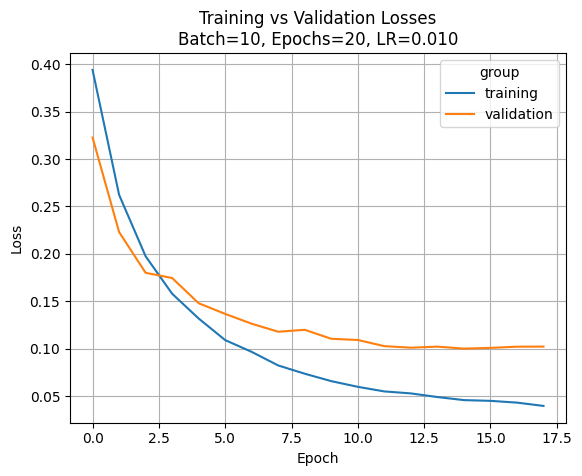

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# print(training_losses)
# print(validation_losses)

training_data = pd.DataFrame({
    'x': range(len(training_losses)),
    'y': training_losses,
    'group': 'training'})

validation_data = pd.DataFrame({
    'x': range(len(validation_losses)),
    'y': validation_losses,
    'group': 'validation'})

# append the new data to the original dataset
data = pd.concat([training_data, validation_data], ignore_index=True)

sns.lineplot(x='x', y='y', hue='group', data=data)
plt.title(f'Training vs Validation Losses\nBatch={BATCH_SIZE}, Epochs={NUM_EPOCHS}, LR={LEARNING_RATE:.3f}')
plt.grid(True)
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()

---
## 5) Evaluate Model

Load model from file if needed

In [ ]:
# Load in the model based on the state file generated  from training
# MODEL_STATE_FILE = 'model_oxford-pet-recongition-v2_Batch10_TrainRatio0p8_Epochs30-LR0p1.pt'
# model.load_state_dict(torch.load(MODEL_STATE_FILE, map_location=torch.device('cpu')))

### First define helper functions
Function will help us
1. parse model output into a prediction data structure
2. render images along with their ground truth annotations and predicted annotations

In [ ]:
# lets create function to take output of fasterrcnn which is in the form of
# (boxes, labels, scores)
# where N is the number of objects detected
# boxes[i] = tensor with shape (N, 4)
# labels[i] tensor with shape (N, 1)
# scores[i] = tensor w shape(N,1)
def get_prediction(model_output) -> dict:
    """
    Returns the highest score prediction from the model output above

    INPUT
    * model_output      -   expected to be output of `fasterrcnn_resnet50_fpn` PyTorch
        built-in model

    OUTPUT
    * dict              - will contain keys 'label', 'box', 'score' containing the
        corresponding values from the highest-scored detection for this input into the data

    """
    # print(output)
    NUM_OUTPUTS = len(model_output)

    best_predictions = []

    #print(f'Model num prediction in provided input: {NUM_OUTPUTS}')
    # for each output row (each row is assosiated to one data row)
    for i in range(len(model_output)):
        # boxes, labels, and scores can have up to N items each. These N
        # represent N objected detected. They are stored in sorted descending
        # order therefore we always take the 1st element in each
        boxes = model_output[i]['boxes'].to(device).detach()
        labels = model_output[i]['labels'].to(device).detach()
        scores = model_output[i]['scores'].to(device).detach()
        # TODO: perhaps our assumption that the first output for label, box, and score
        # carried the highest confidence result...use
        #   max_value, max_index = torch.max(x, dim=0)
        # so find the index of the highest score and then fetch
        # the label, box, and score from that index
        best_predictions.append({
            'label': labels[0] if labels.any() else None,
            'box': boxes[0] if boxes.any() else None,
            'score': scores[0] if scores.any() else None
        })

        #print(f'i = {i}, prediction = {best_predictions[i]}')

    return best_predictions

# predictions = get_prediction(output)

In [ ]:
from torchvision.utils import draw_bounding_boxes

def display_images_with_predictions(batch_images, batch_predictions, batch_ground_truths):
    # from: https://pytorch.org/vision/main/auto_examples/others/plot_visualization_utils.html#visualizing-bounding-boxes

    BATCH_SIZE = len(batch_images)
    # we already have images stored in a list as input to the model
    # Display a sample set of 10 images with their predicted bounding box overlaid
    # including label for each including its predicted class/label
    fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(12, 9))
    fig.suptitle('Ground Truth (gt) vs Prediction (p)\ngt - rendered in blue in image\np - rendered in green if correct, blue otherwise')

    for i in range(BATCH_SIZE if BATCH_SIZE <= 10 else 10):
        # process image for rendering
        img = batch_images[i].clone()
        img = createPlottableImage(unnormalize(img))

        # Get ground truth annotations data points
        ground_truth_label = batch_ground_truths[i][0]
        ground_truth_labelname = label_to_labelname[ground_truth_label]
        ground_truth_bbox = batch_ground_truths[i][1]
        # Get predicted annotations
        pred_bbox = torch.tensor(batch_predictions[i]['box']) if batch_predictions[i]['box'] is not None else None
        pred_label = batch_predictions[i]['label']
        pred_score = batch_predictions[i]['score']

        # determine where in the plot grid we are going to plot next
        ax = axes[int(i / 5) , i % 5]
        ax.axis('off')

        # skip anything data that was not recognized
        if pred_bbox is None or pred_label is None or pred_score is None:


            img = img * 255

            # redajust the ordering of the image dimension (C x H x W) <-> (H x W x C)
            img = torch.tensor(img, dtype=torch.uint8)

            img = torch.permute(img, (2, 0, 1))
            img_with_box = draw_bounding_boxes(img, torch.tensor([ground_truth_bbox]),
                                               colors=['blue'],
                                               width=6)

            img_with_box = torch.permute(img_with_box, (1, 2, 0))
            ax.set_title(f"gt: {ground_truth_label} = {ground_truth_labelname}\np: no object detected",
                         color=('red'))
            ax.imshow(img_with_box)
        else:
            # process img for bounding box image render
            # originally in tensor form image was [0,1] floating point
            # converting it top uint8 will make the image [0,1] be interpreted
            # in terms of [0,255]...we need to then multiply the image by 255
            # to correctly map the [0,1] values to [0,255] for rendering with the bounding
            # boxes
            img = img * 255
            img = torch.tensor(img, dtype=torch.uint8)

            # redajust the ordering of the image dimension (C x H x W) <-> (H x W x C)
            img = torch.permute(img, (2, 0, 1))

            # determine if we were wrong with our prediction
            is_correct_label = (pred_label == ground_truth_label)
            img_with_box = draw_bounding_boxes(img, torch.tensor(pred_bbox).reshape(1,4),
                                               colors=['green' if is_correct_label else 'red'],
                                               width=6)
            # now draw ground truth bounding box
            img_with_box = draw_bounding_boxes(img_with_box, torch.tensor([ground_truth_bbox]),
                                               colors=['blue'],
                                               width=6)
            #print(img_with_box.shape)
            img_with_box = torch.permute(img_with_box, (1, 2, 0))
            ax.set_title(f"gt: {ground_truth_label} = {ground_truth_labelname}\np: {pred_label} = {label_to_labelname[pred_label]}",
                         color=('green' if is_correct_label else 'red'))
            ax.imshow(img_with_box)
        # end - if-else
    # end - for loop
    plt.show()


  0%|          | 0/37 [00:00<?, ?it/s]

		<--- BATCH #0


<ipython-input-42-0cf201aeb092>:23: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  pred_bbox = torch.tensor(batch_predictions[i]['box']) if batch_predictions[i]['box'] is not None else None
<ipython-input-42-0cf201aeb092>:64: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img_with_box = draw_bounding_boxes(img, torch.tensor(pred_bbox).reshape(1,4),


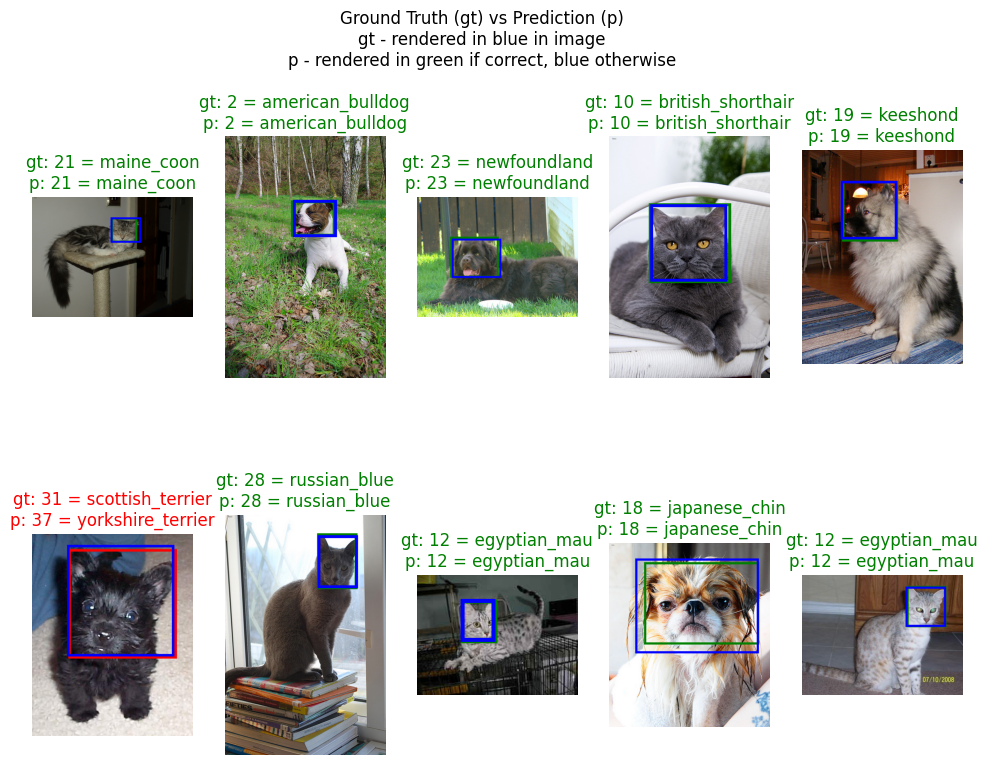

  3%|▎         | 1/37 [00:00<00:32,  1.10it/s]

		<--- BATCH #1


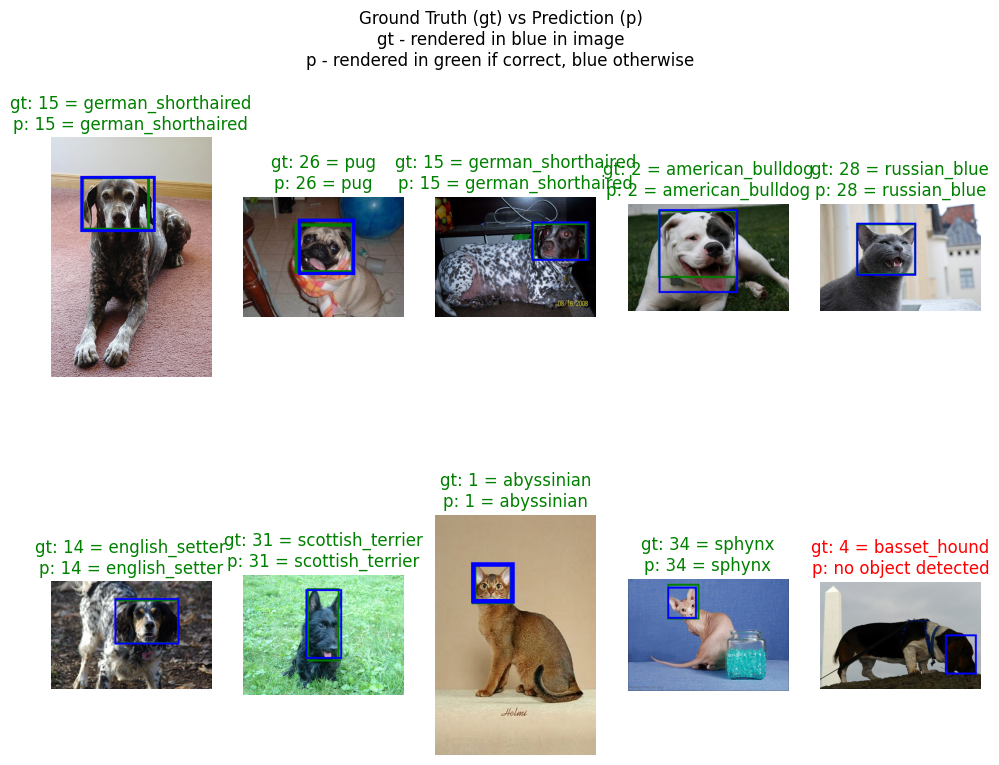

  5%|▌         | 2/37 [00:01<00:35,  1.00s/it]

		<--- BATCH #2


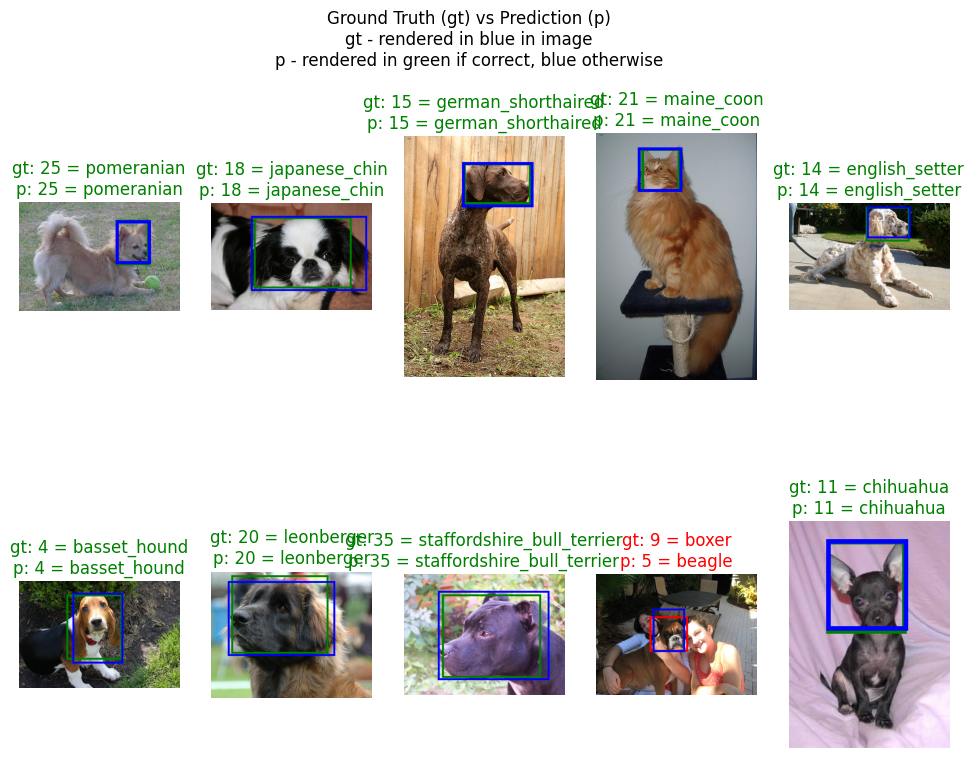

  8%|▊         | 3/37 [00:02<00:32,  1.05it/s]

		<--- BATCH #3


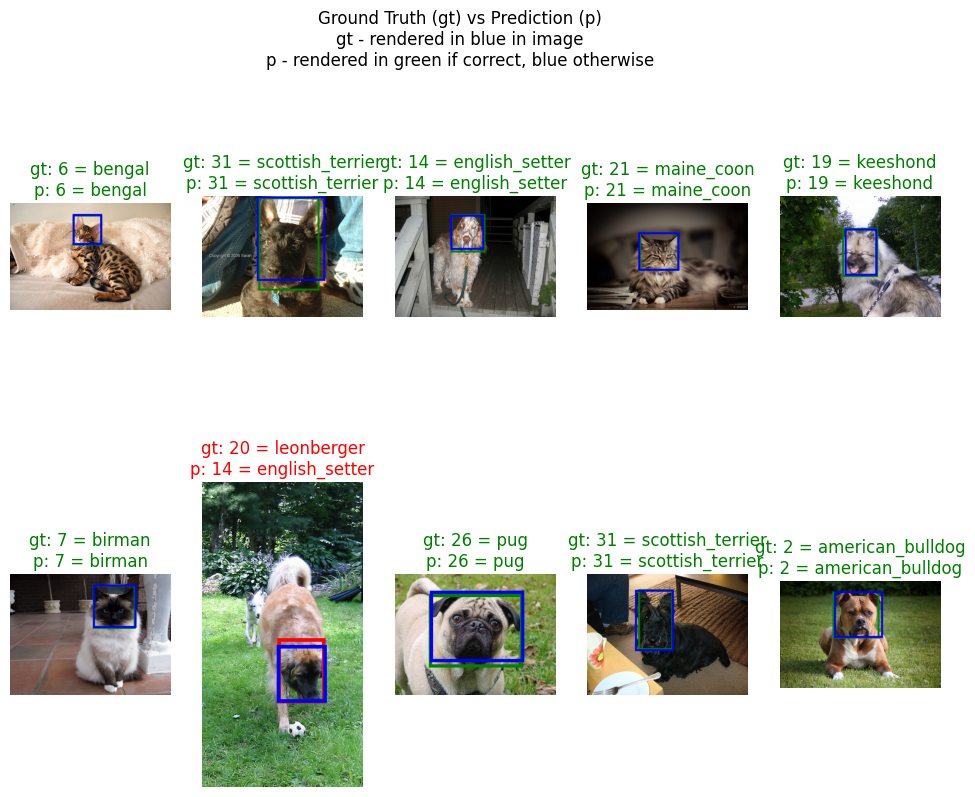

 11%|█         | 4/37 [00:03<00:30,  1.09it/s]

		<--- BATCH #4


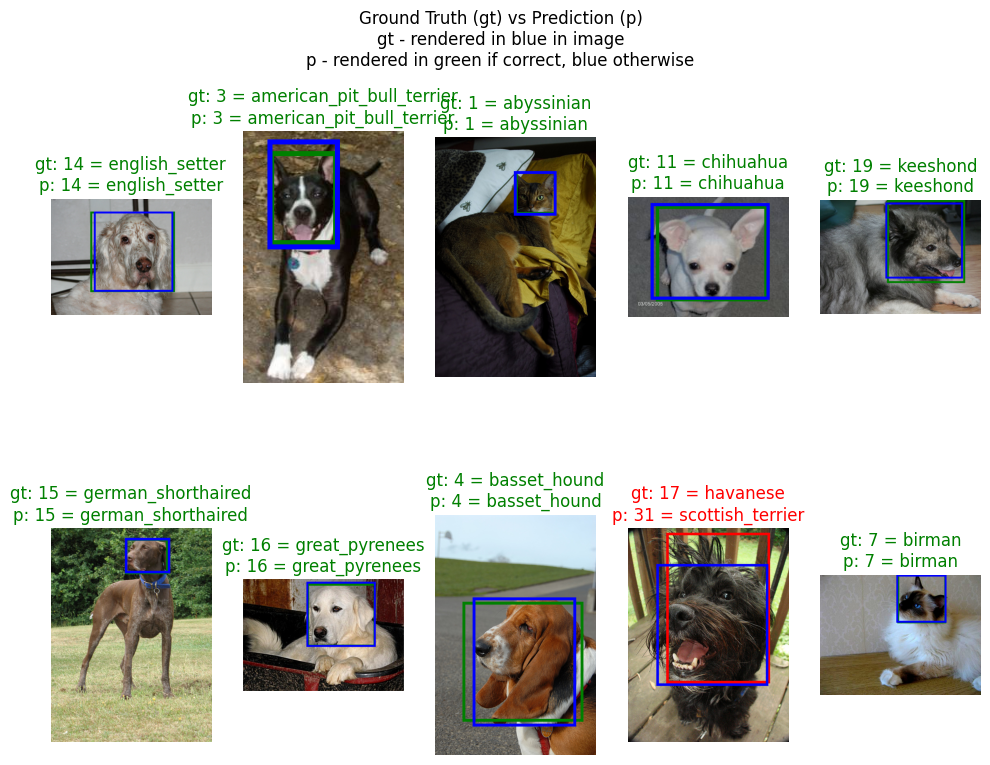

 14%|█▎        | 5/37 [00:04<00:29,  1.09it/s]

		<--- BATCH #5


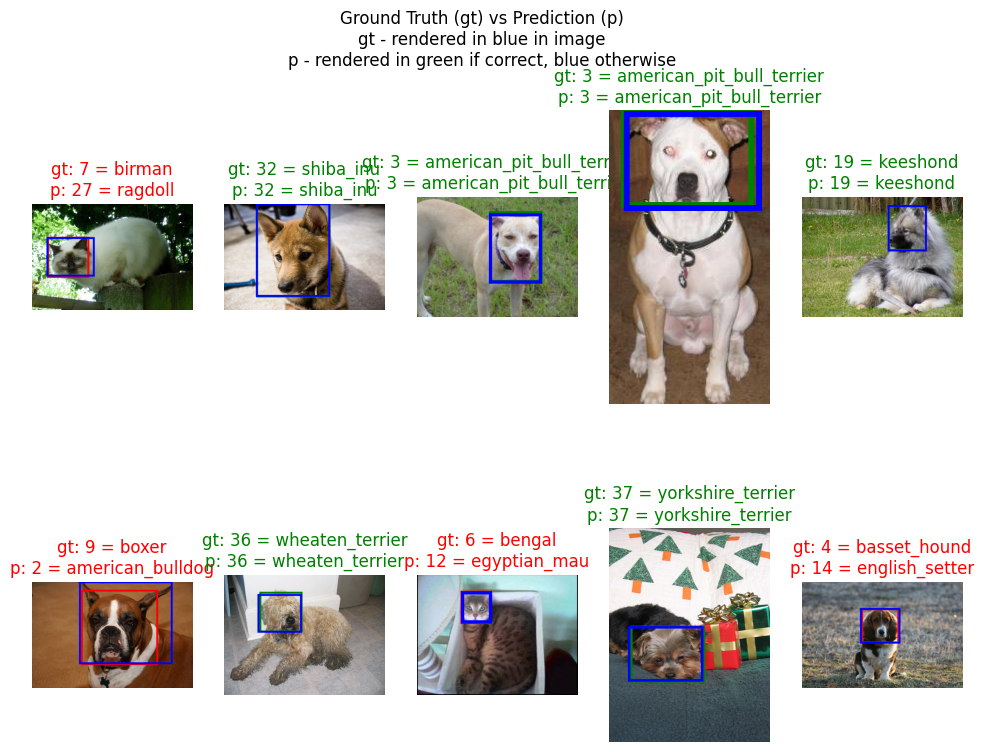

 16%|█▌        | 6/37 [00:05<00:28,  1.10it/s]

		<--- BATCH #6


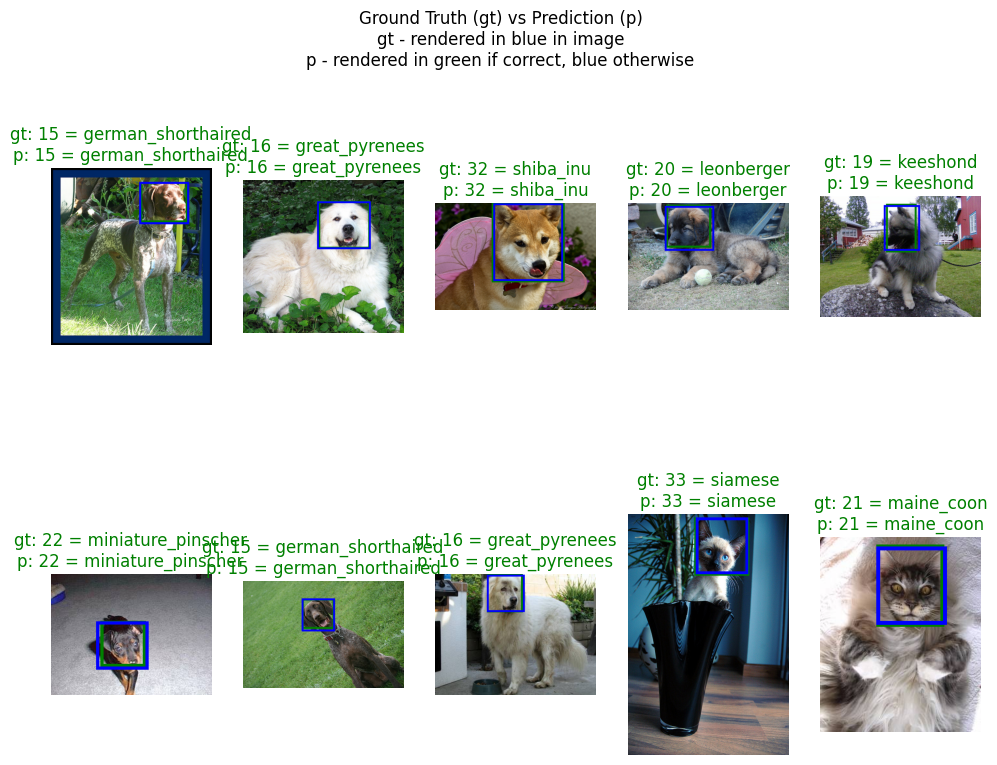

 19%|█▉        | 7/37 [00:06<00:27,  1.11it/s]

		<--- BATCH #7


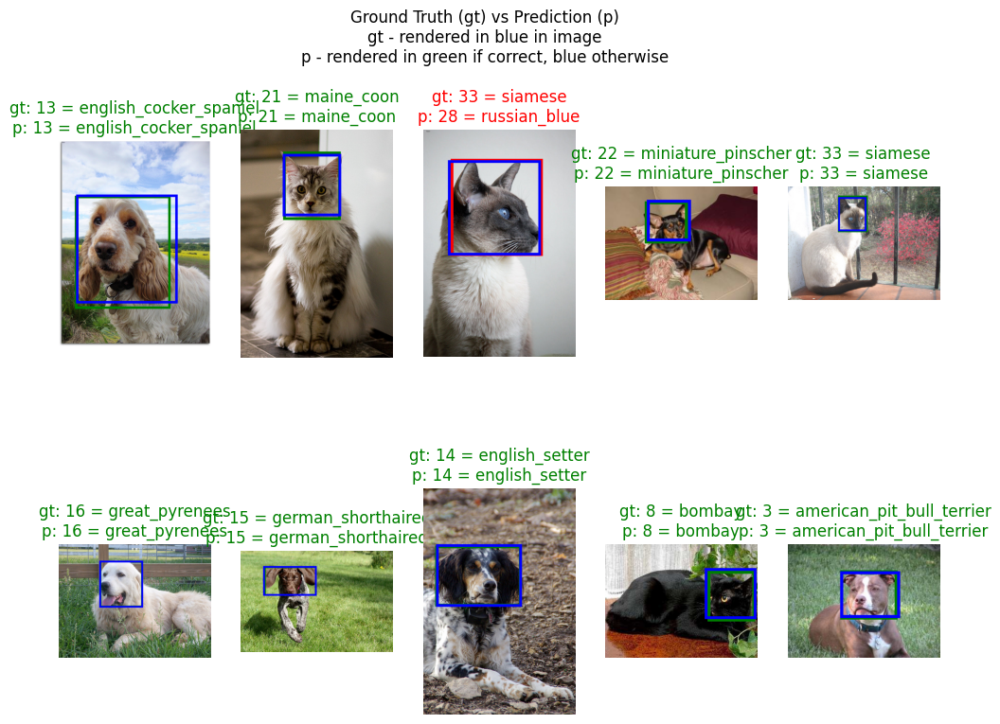

 22%|██▏       | 8/37 [00:07<00:28,  1.02it/s]

		<--- BATCH #8


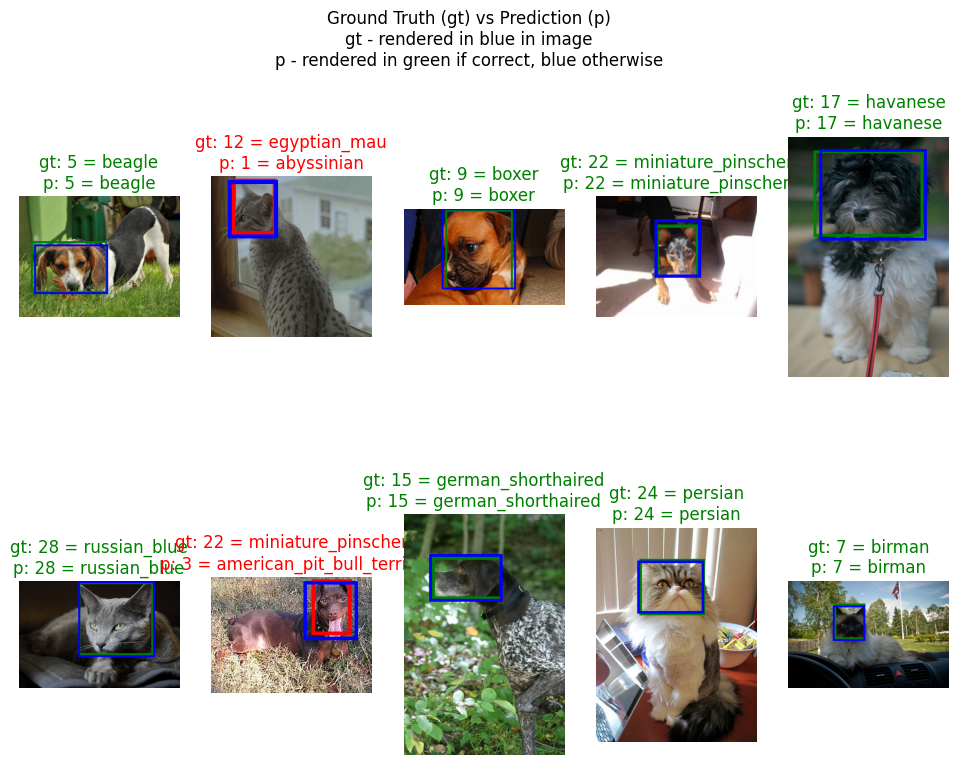

 24%|██▍       | 9/37 [00:08<00:26,  1.06it/s]

		<--- BATCH #9


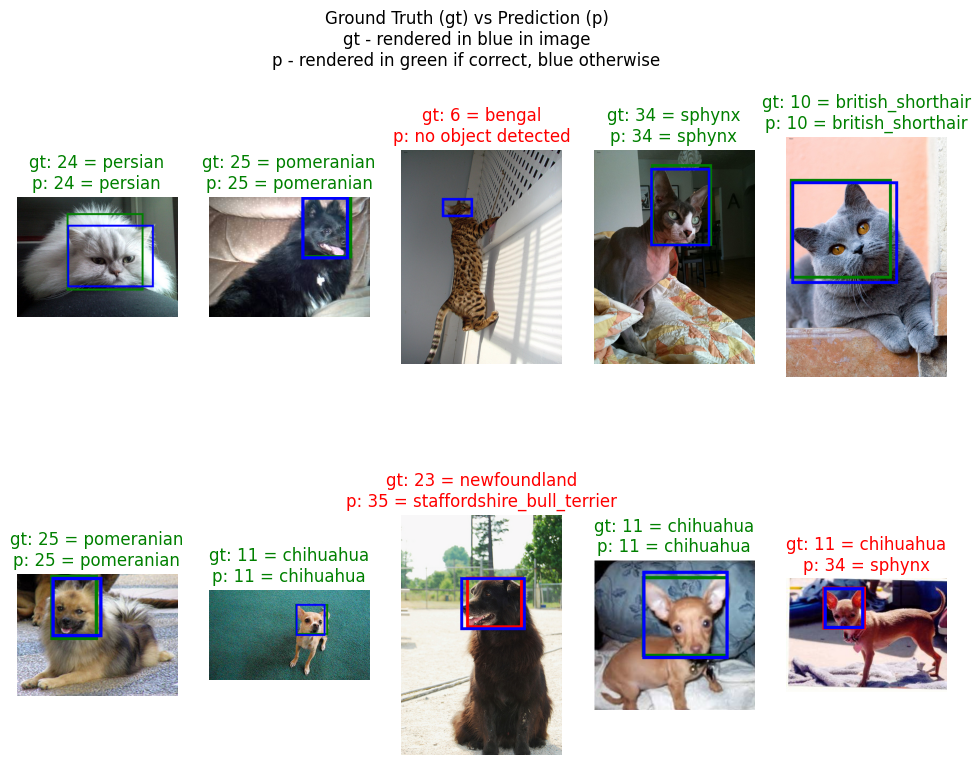

 27%|██▋       | 10/37 [00:09<00:24,  1.08it/s]

		<--- BATCH #10


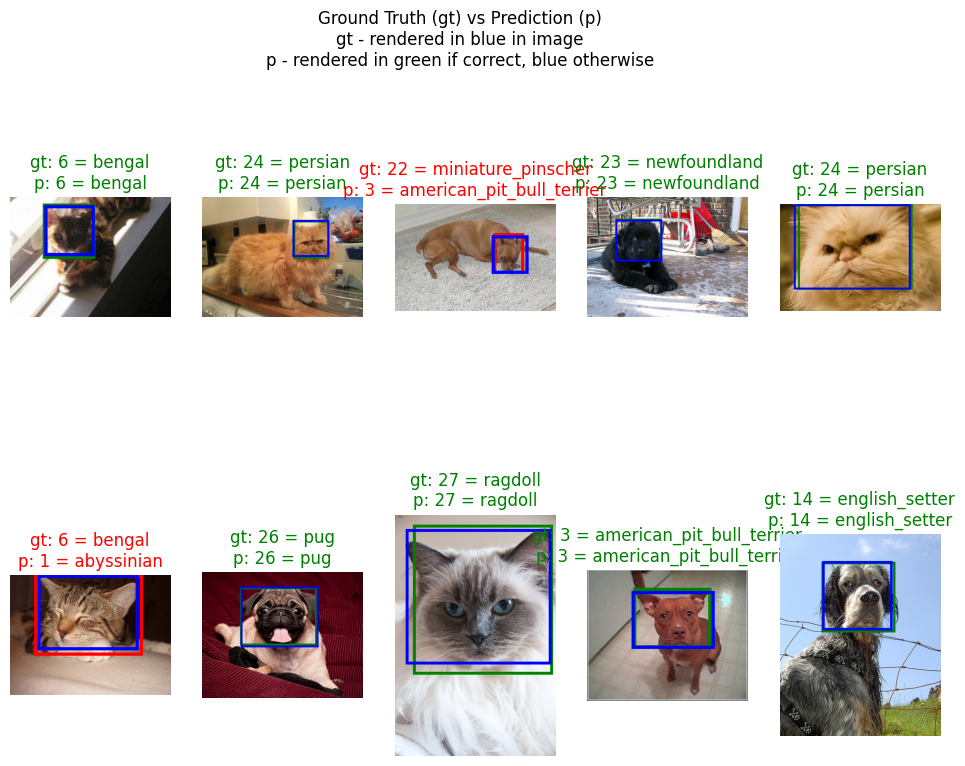

 30%|██▉       | 11/37 [00:10<00:23,  1.12it/s]

		<--- BATCH #11


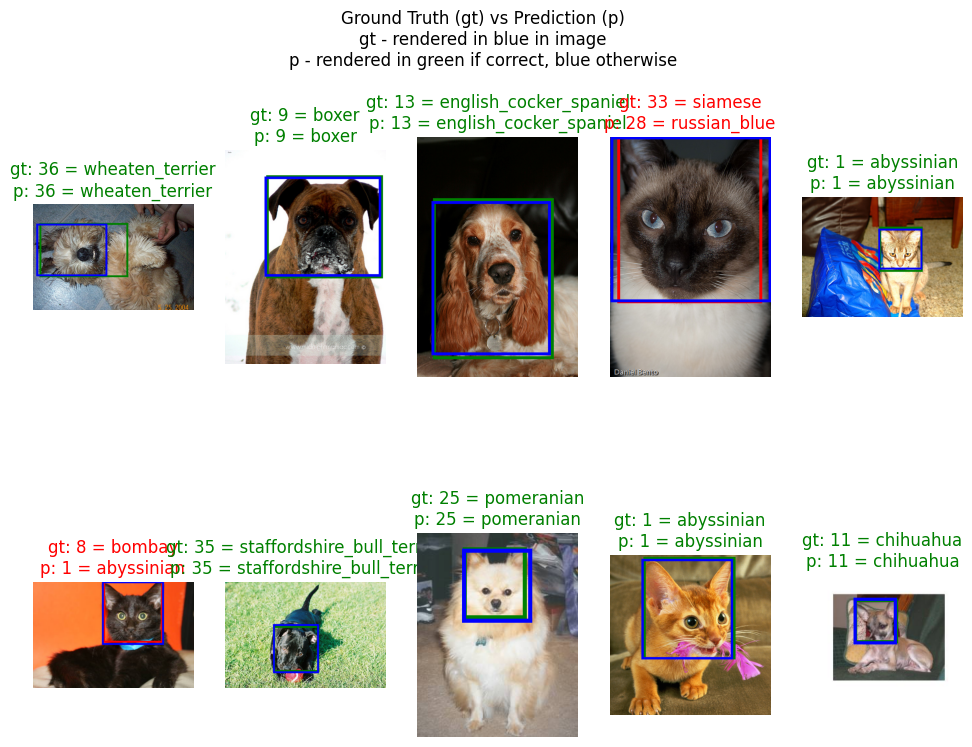

 32%|███▏      | 12/37 [00:11<00:22,  1.13it/s]

		<--- BATCH #12


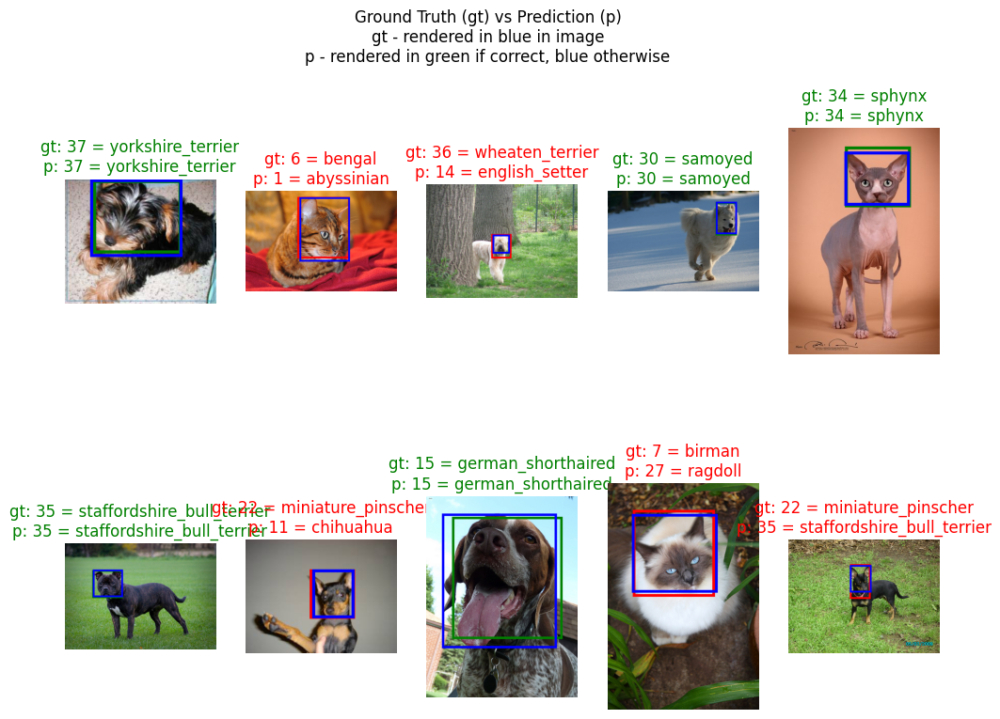

 35%|███▌      | 13/37 [00:11<00:21,  1.14it/s]

		<--- BATCH #13


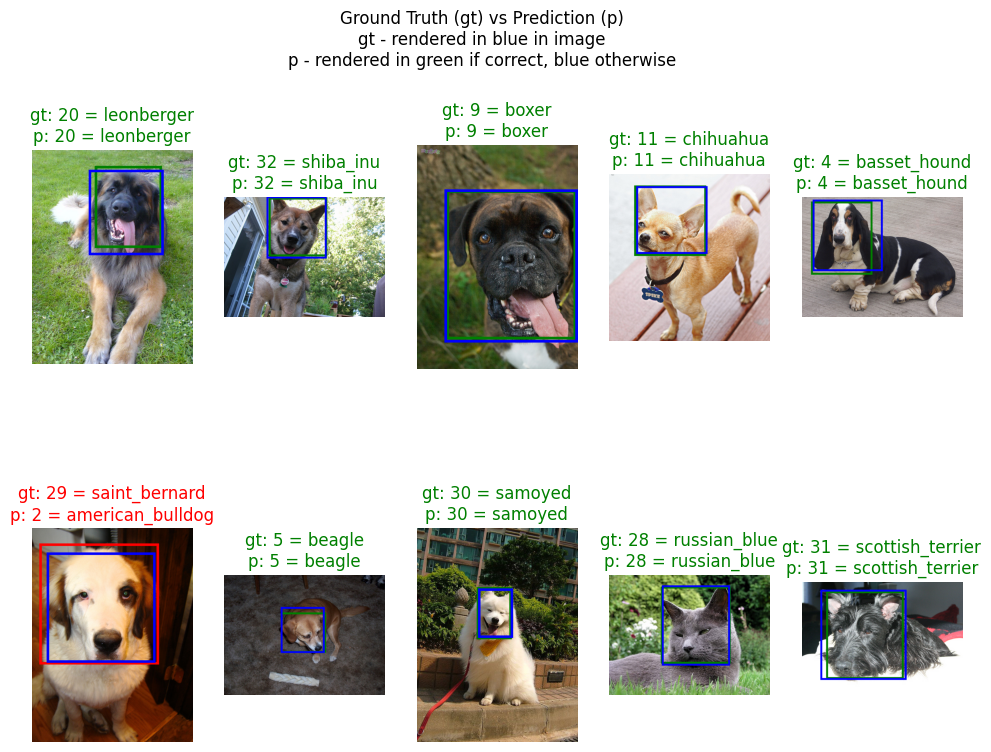

 38%|███▊      | 14/37 [00:13<00:22,  1.04it/s]

		<--- BATCH #14


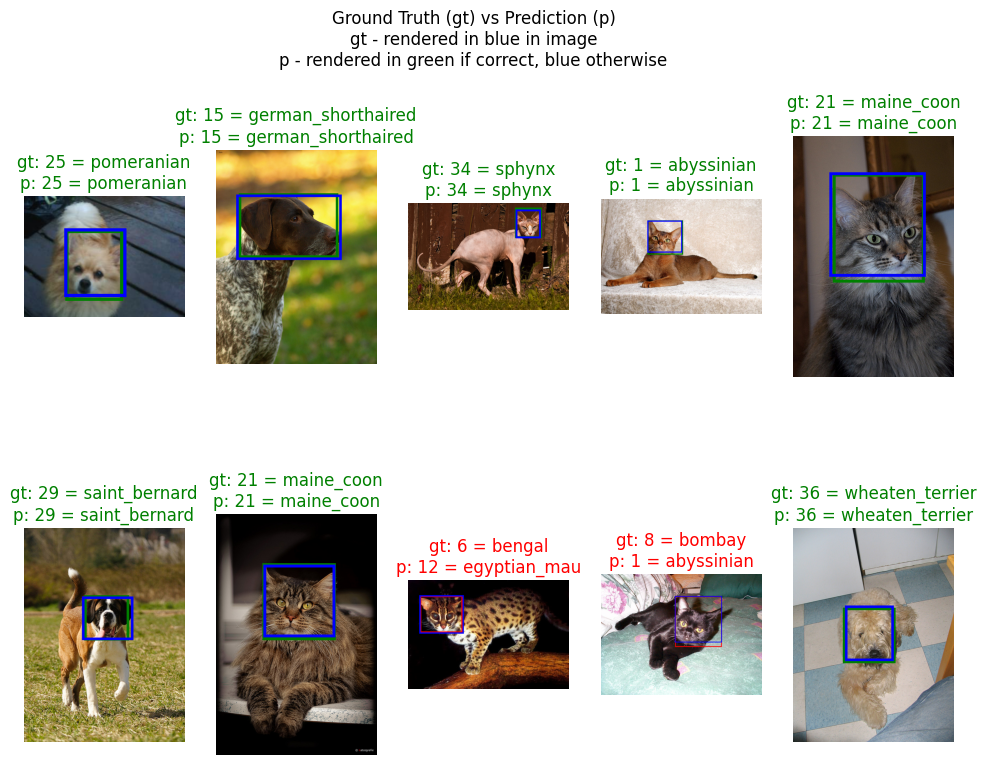

 41%|████      | 15/37 [00:14<00:21,  1.02it/s]

		<--- BATCH #15


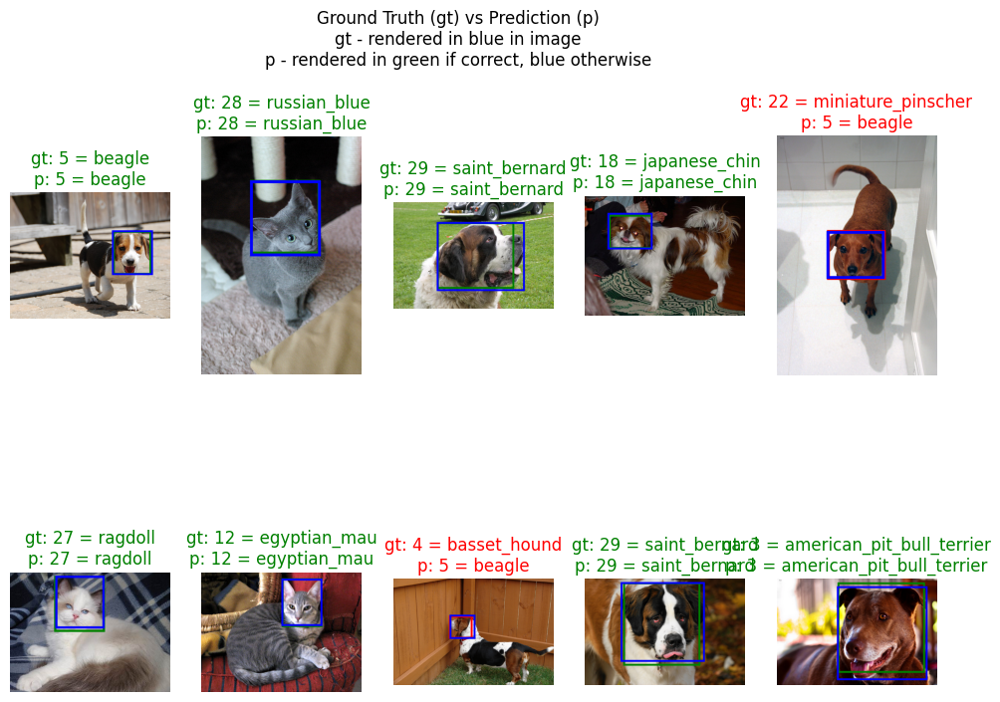

 43%|████▎     | 16/37 [00:14<00:20,  1.05it/s]

		<--- BATCH #16


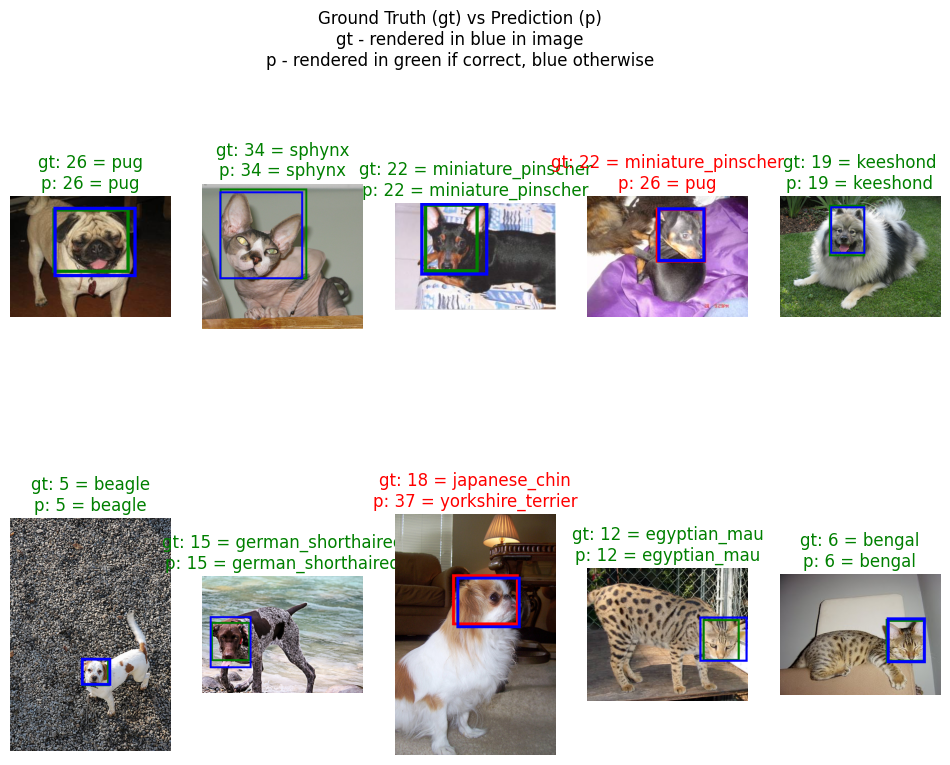

 46%|████▌     | 17/37 [00:15<00:18,  1.09it/s]

		<--- BATCH #17


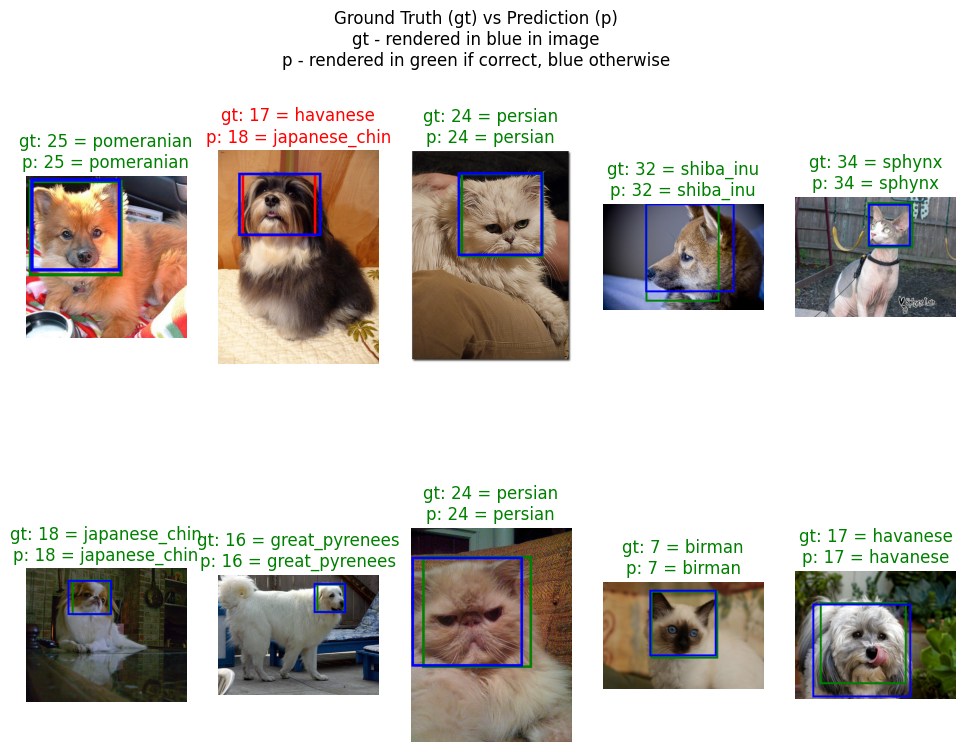

 49%|████▊     | 18/37 [00:16<00:17,  1.10it/s]

		<--- BATCH #18


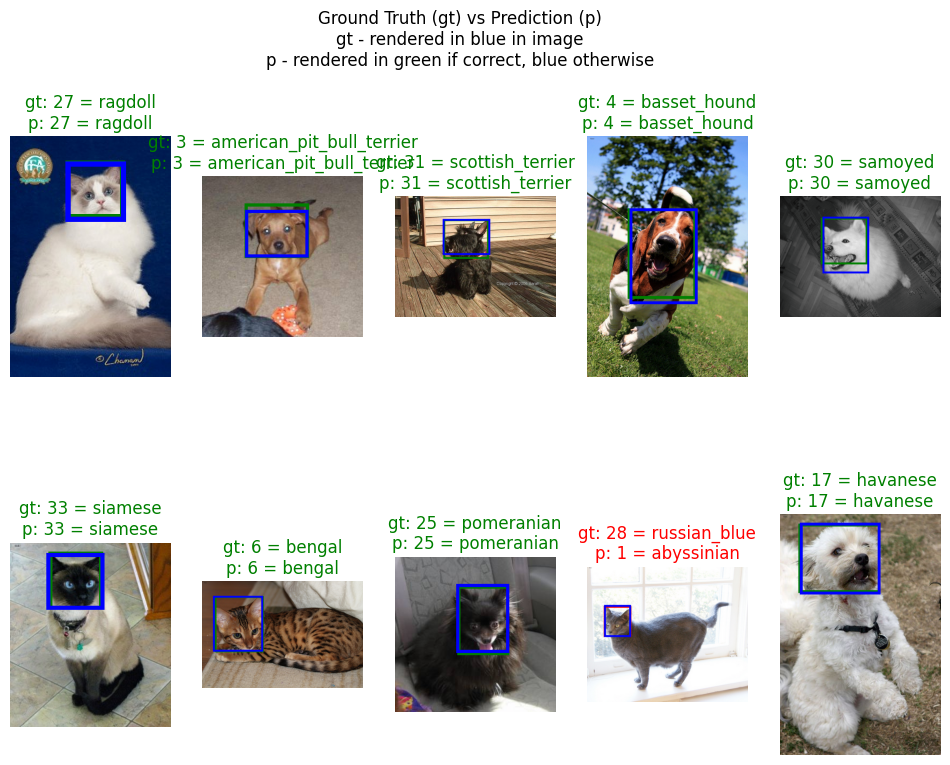

 51%|█████▏    | 19/37 [00:17<00:16,  1.11it/s]

		<--- BATCH #19


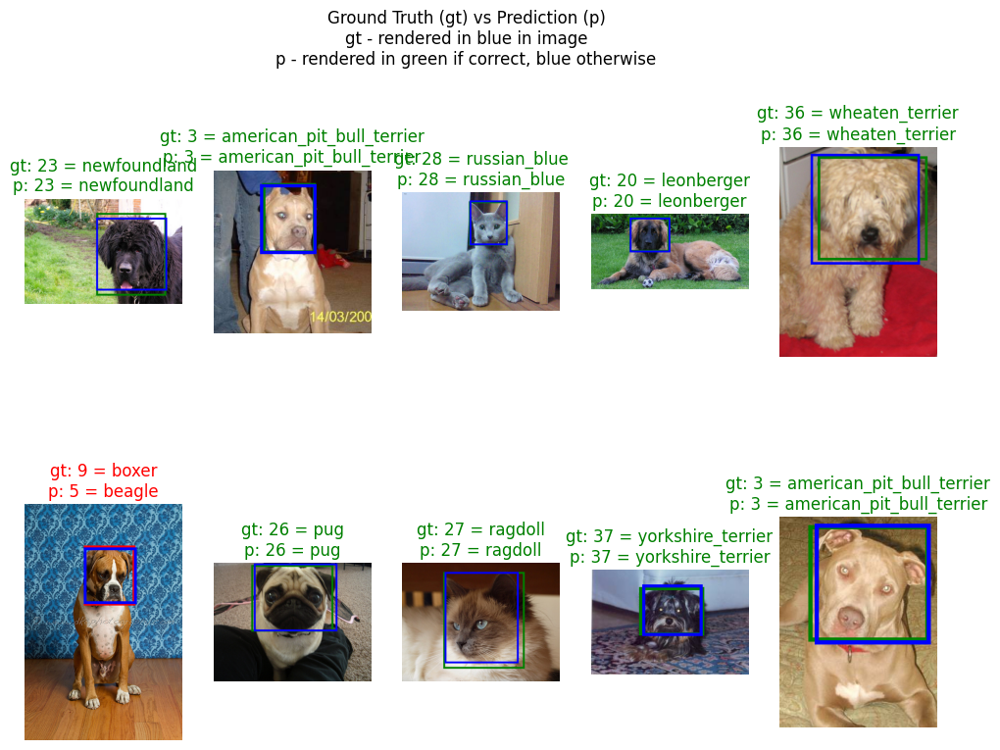

 54%|█████▍    | 20/37 [00:18<00:16,  1.03it/s]

		<--- BATCH #20


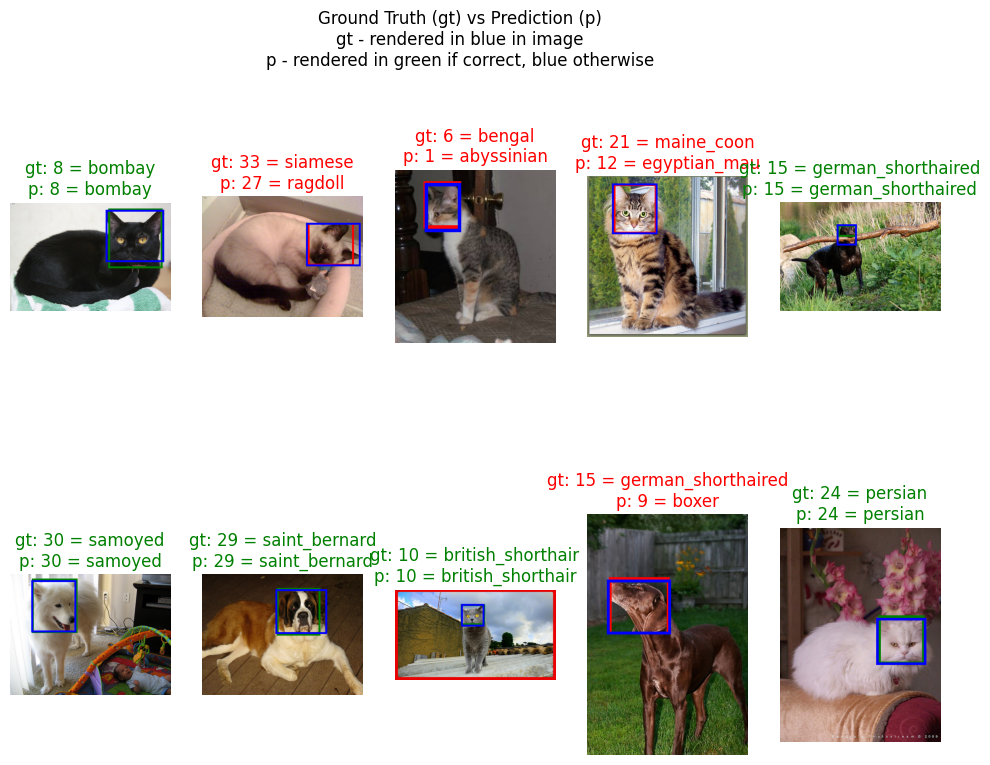

 57%|█████▋    | 21/37 [00:19<00:15,  1.05it/s]

		<--- BATCH #21


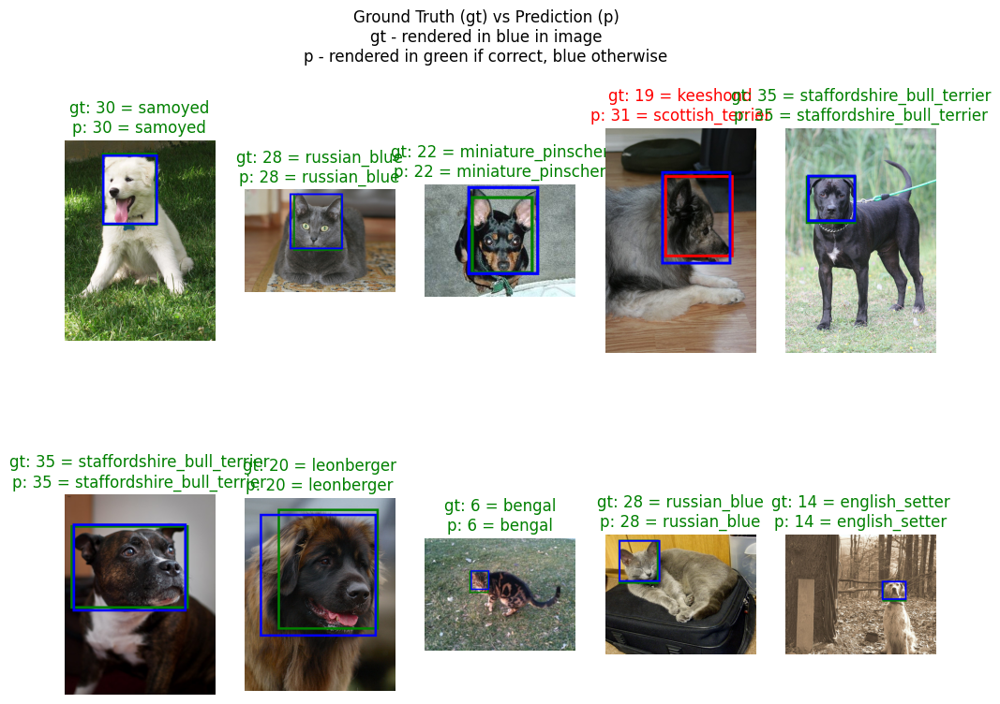

 59%|█████▉    | 22/37 [00:20<00:14,  1.06it/s]

		<--- BATCH #22


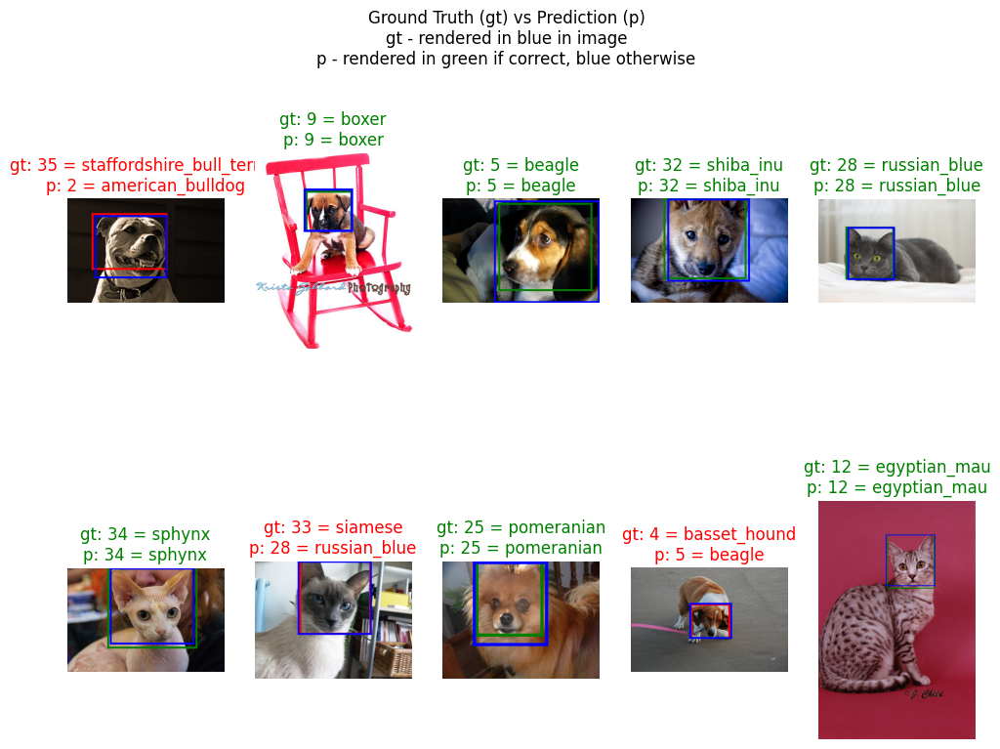

 62%|██████▏   | 23/37 [00:21<00:13,  1.03it/s]

		<--- BATCH #23


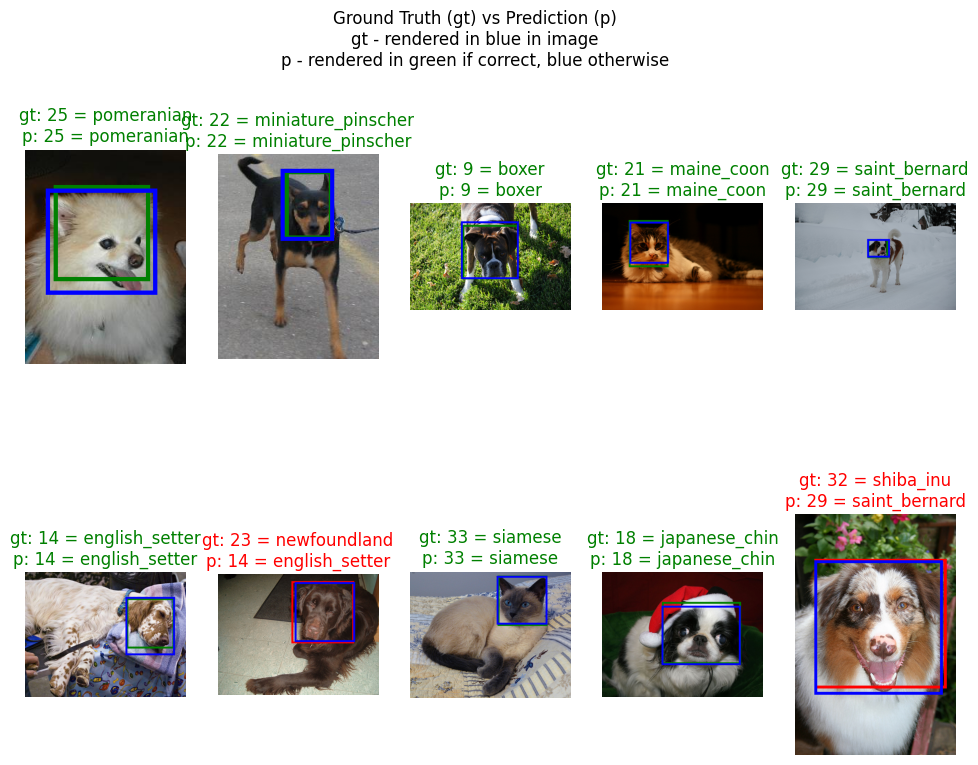

 65%|██████▍   | 24/37 [00:22<00:12,  1.06it/s]

		<--- BATCH #24


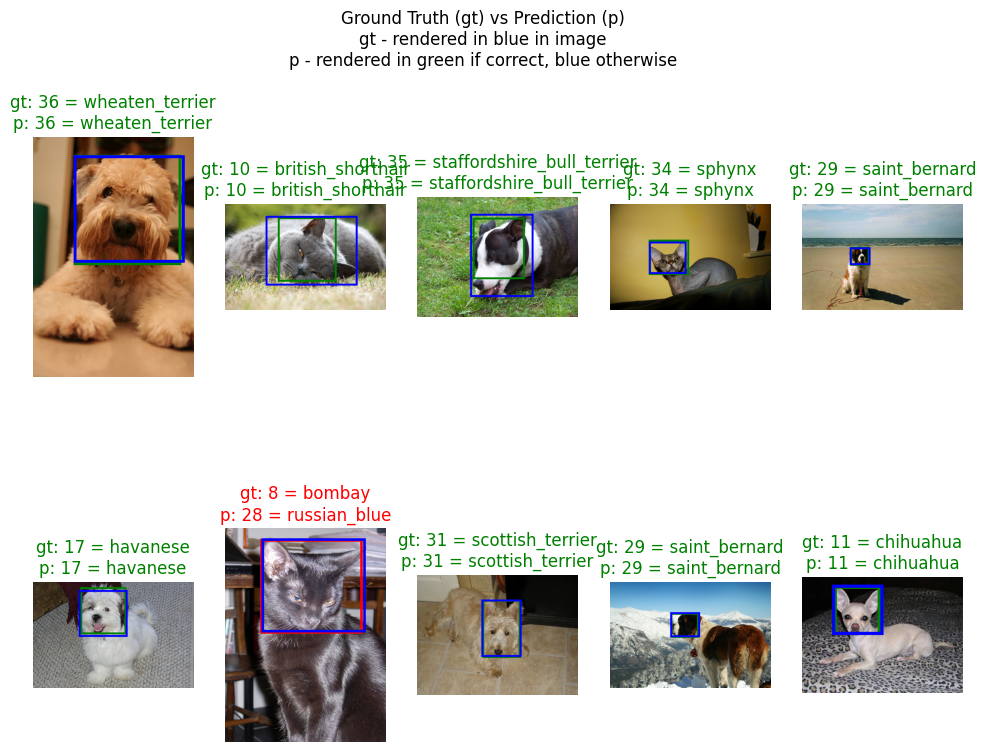

 68%|██████▊   | 25/37 [00:23<00:11,  1.08it/s]

		<--- BATCH #25


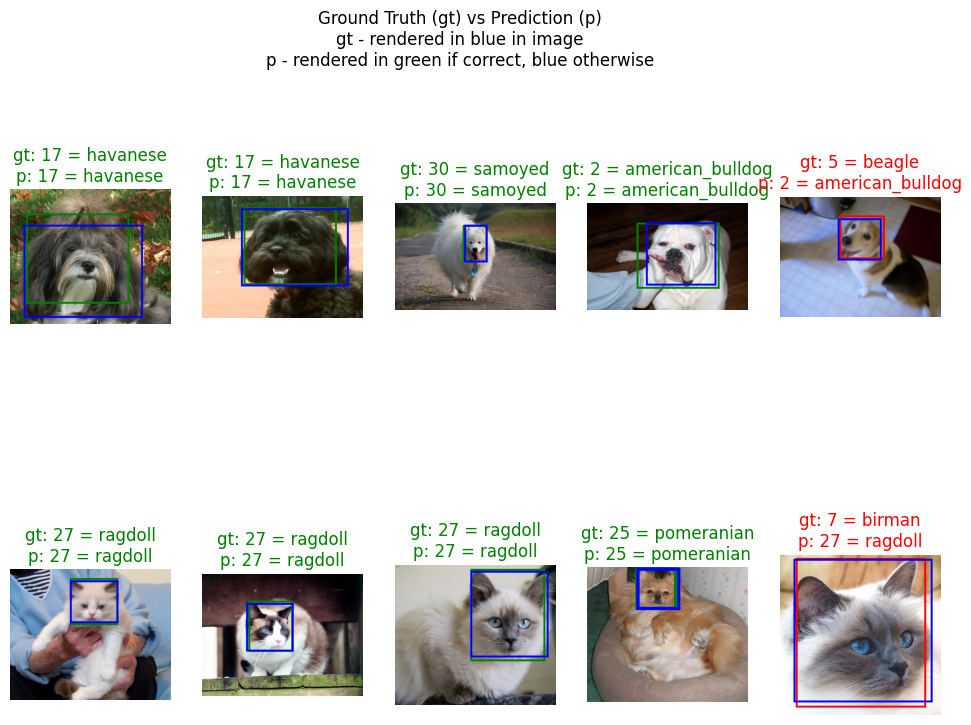

 70%|███████   | 26/37 [00:24<00:10,  1.03it/s]

		<--- BATCH #26


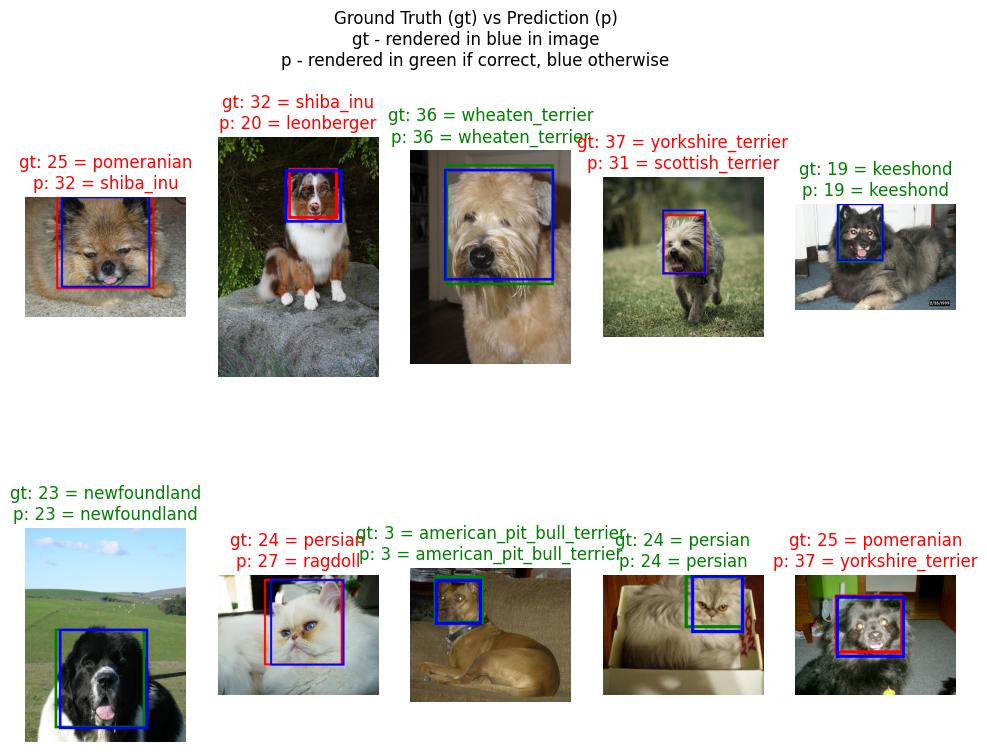

 73%|███████▎  | 27/37 [00:25<00:09,  1.05it/s]

		<--- BATCH #27


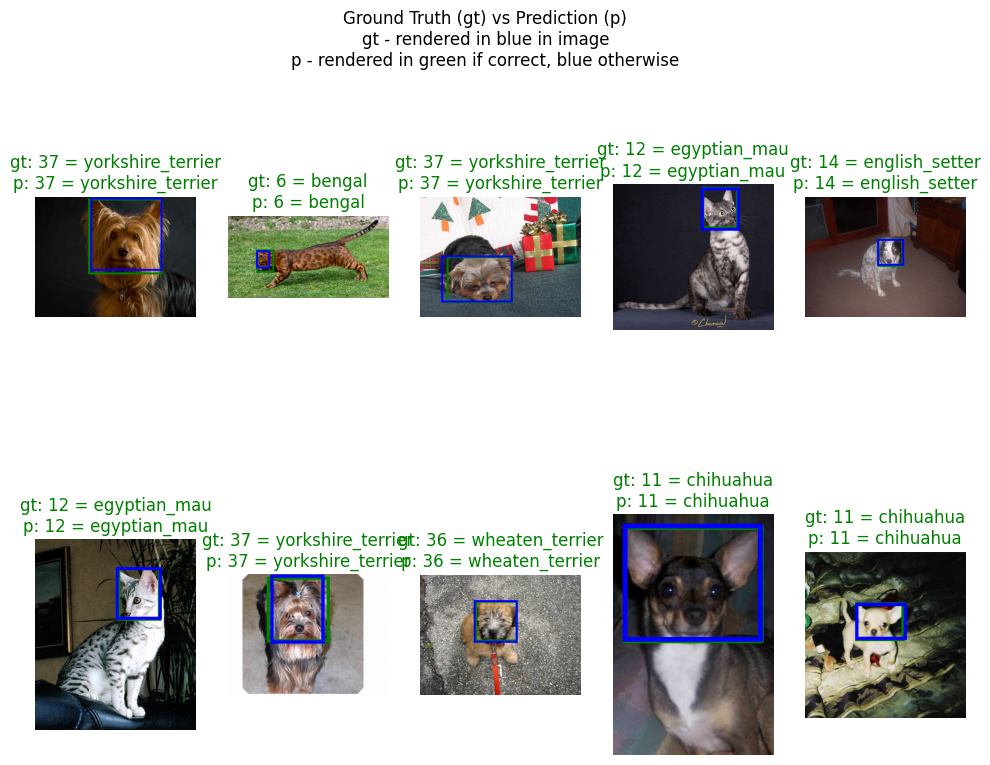

 76%|███████▌  | 28/37 [00:26<00:08,  1.08it/s]

		<--- BATCH #28


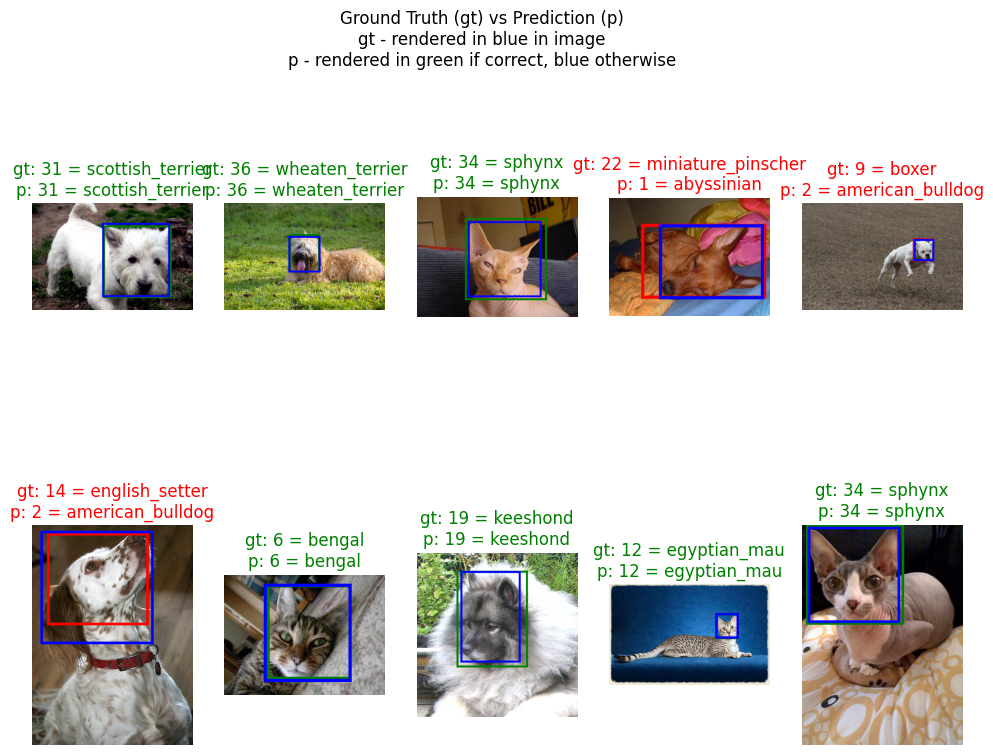

 78%|███████▊  | 29/37 [00:27<00:07,  1.10it/s]

		<--- BATCH #29


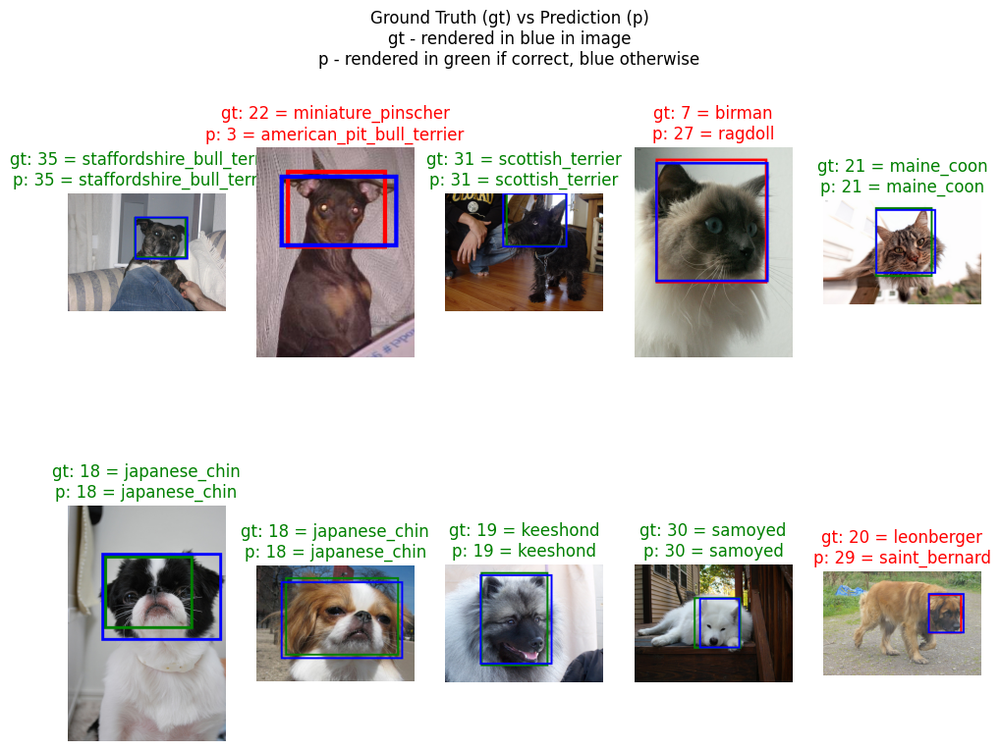

 81%|████████  | 30/37 [00:27<00:06,  1.10it/s]

		<--- BATCH #30


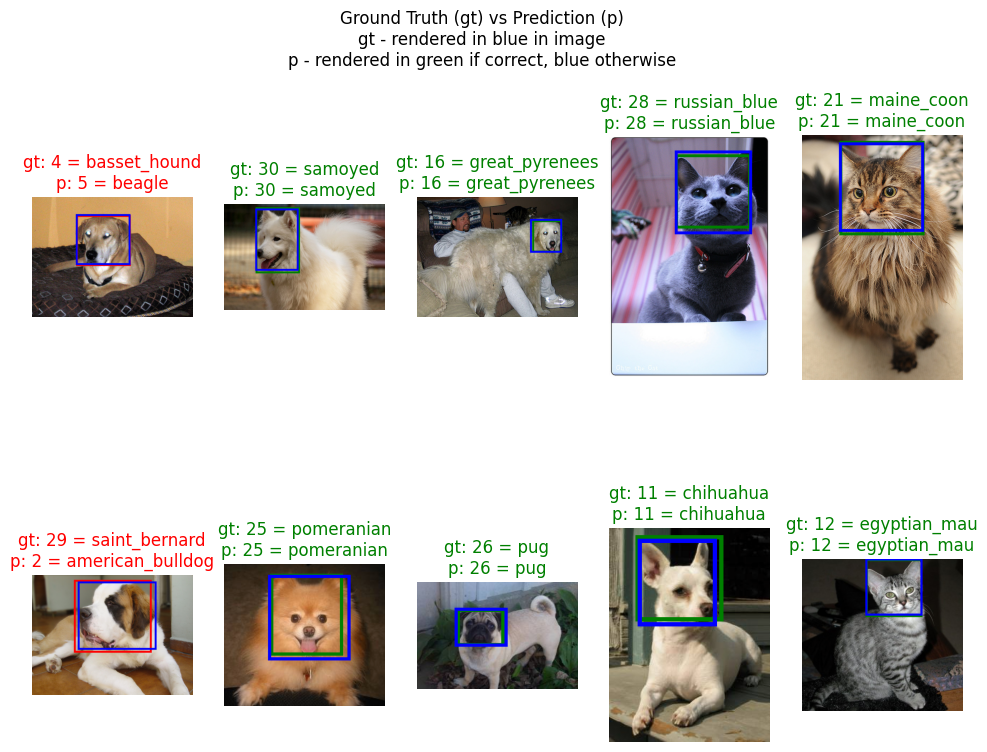

 84%|████████▍ | 31/37 [00:28<00:05,  1.10it/s]

		<--- BATCH #31


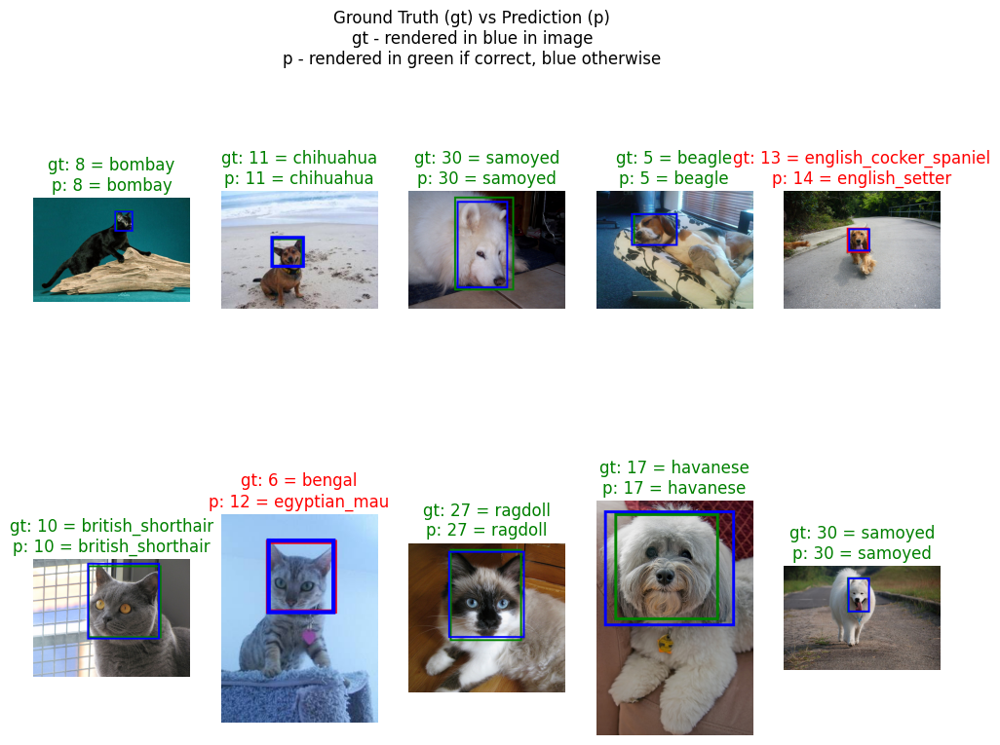

 86%|████████▋ | 32/37 [00:29<00:04,  1.03it/s]

		<--- BATCH #32


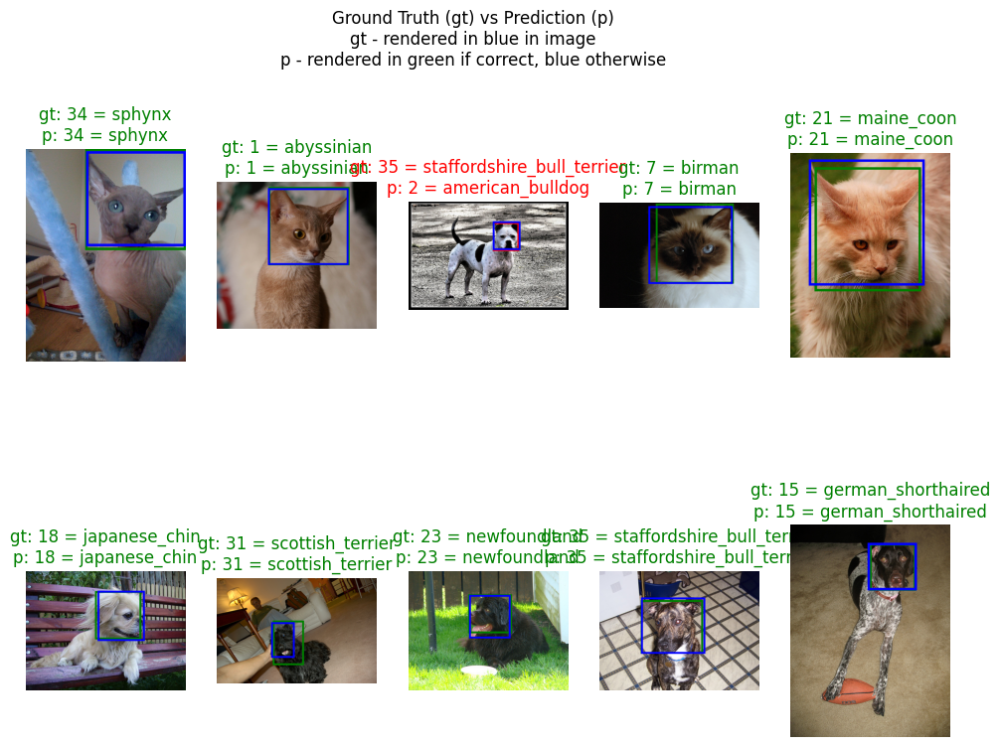

 89%|████████▉ | 33/37 [00:30<00:03,  1.05it/s]

		<--- BATCH #33


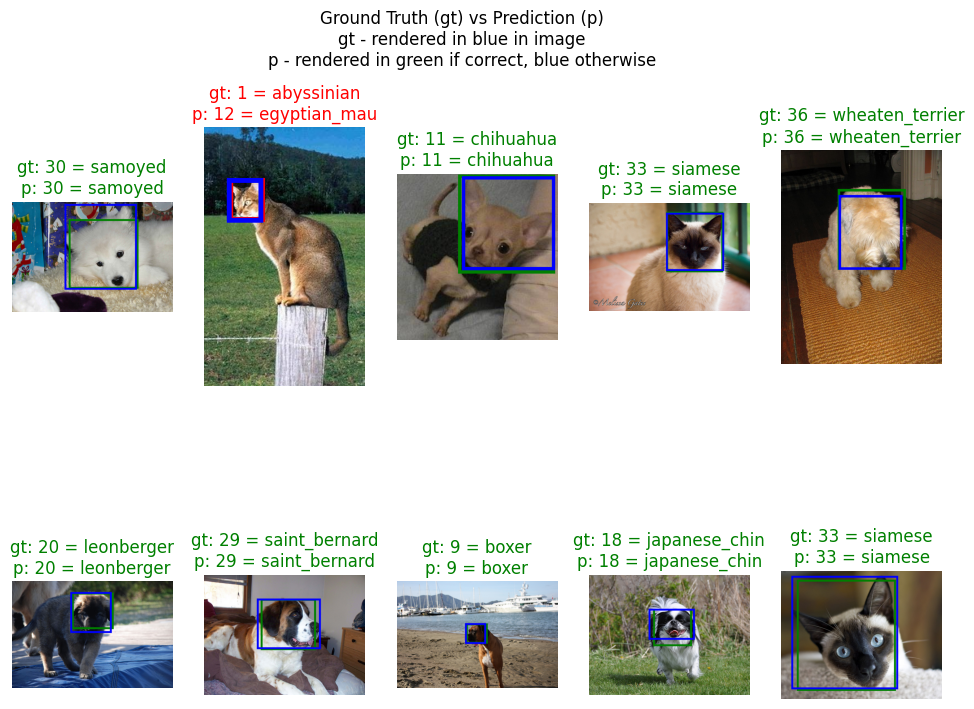

 92%|█████████▏| 34/37 [00:31<00:02,  1.08it/s]

		<--- BATCH #34


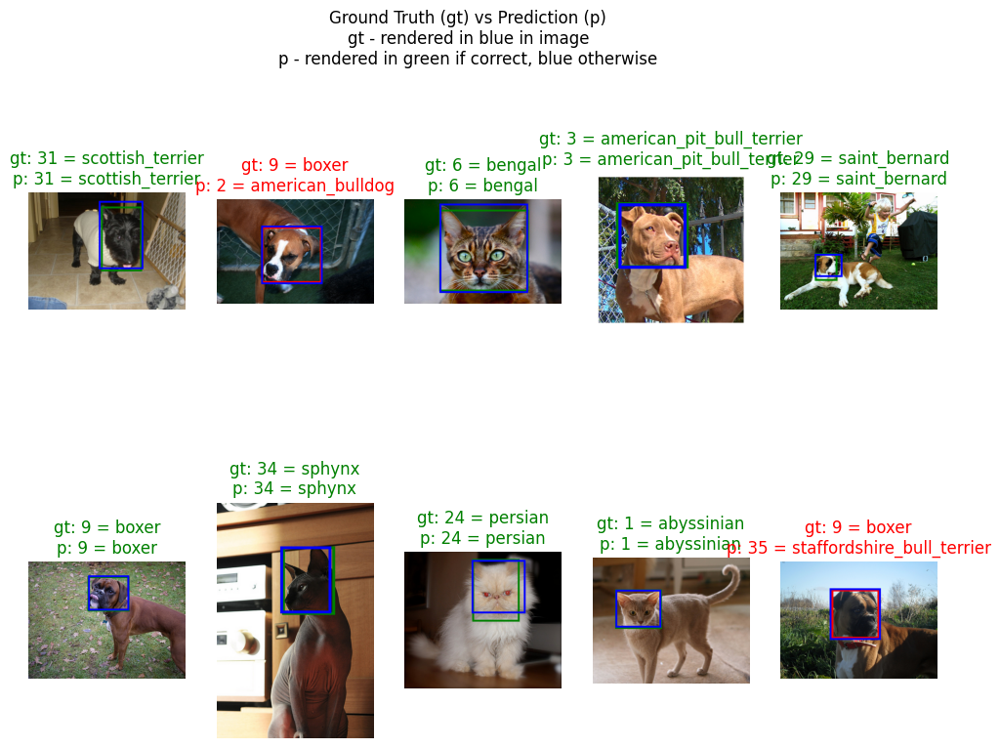

 95%|█████████▍| 35/37 [00:32<00:01,  1.09it/s]

		<--- BATCH #35


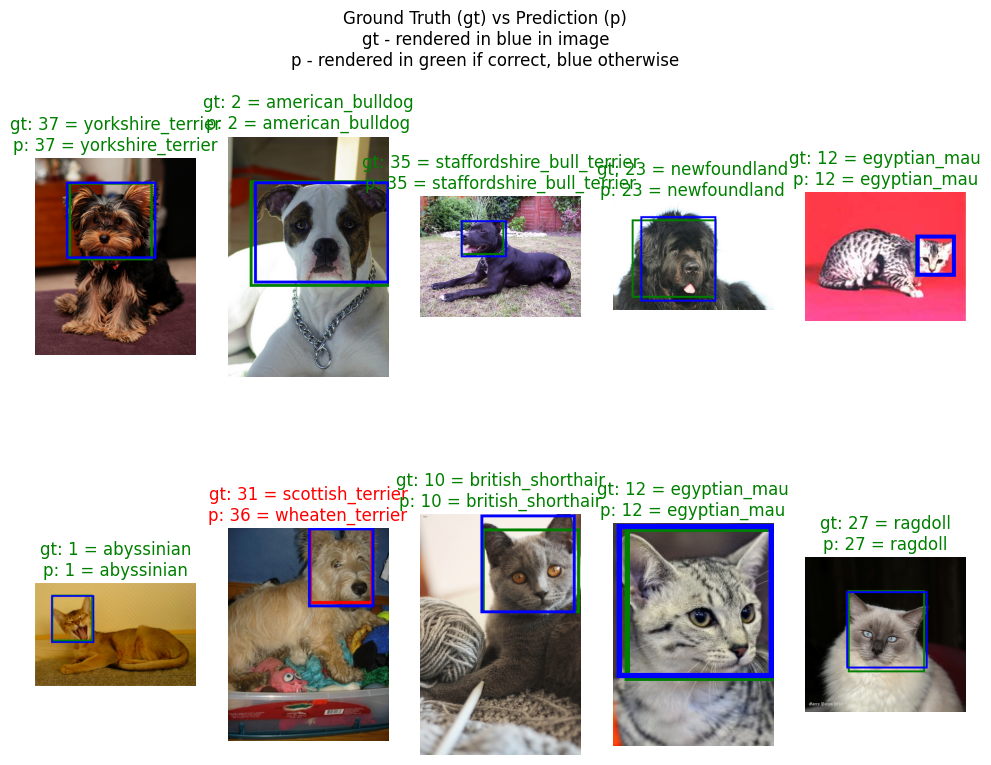

 97%|█████████▋| 36/37 [00:33<00:00,  1.10it/s]

		<--- BATCH #36


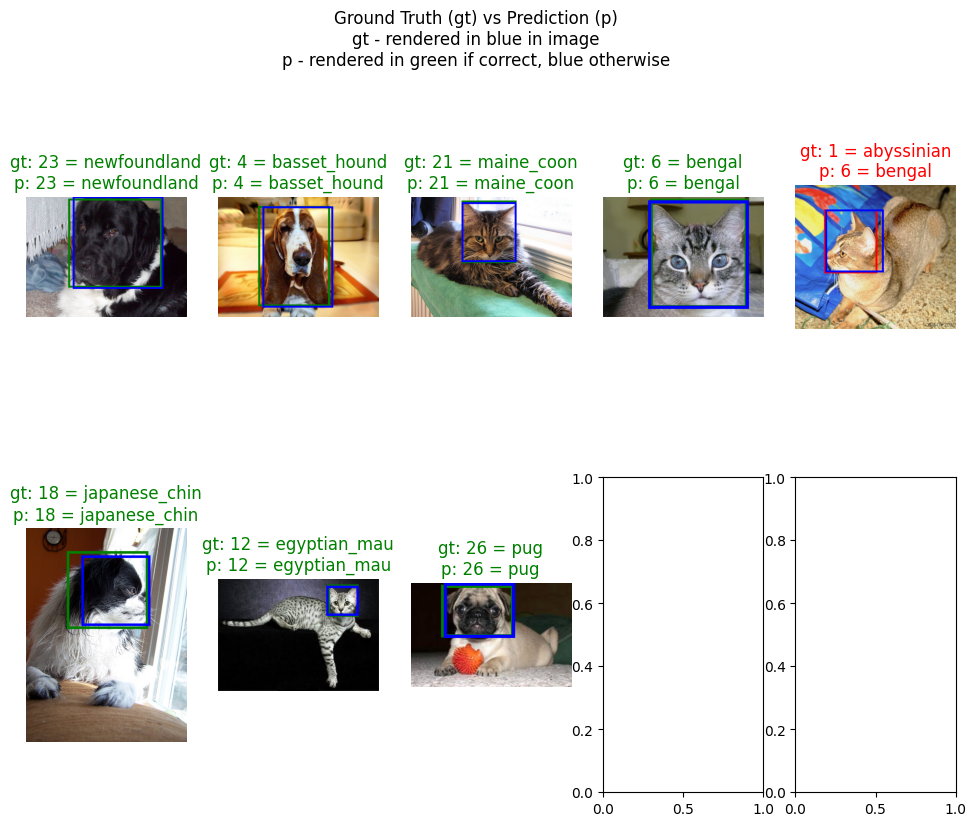

100%|██████████| 37/37 [00:34<00:00,  1.08it/s]


total data: 368
correct data: 300
Percent correct: 81.52%


In [ ]:
#######################
## TEST - this will output a accuracy score percentage and displa
## images for each test image
########################
with torch.no_grad(): # from: https://debuggercafe.com/a-simple-pipeline-to-train-pytorch-faster-rcnn-object-detection-model/
  model.eval()       # put model in evaluation mode
  count_correct = 0
  count_total = 0
  for i,data in enumerate(tqdm(test_loader)):
      print(f'\t\t<--- BATCH #{i}')
      features, annotations = data
      # Build the images and targets needed for input into the model
      images = list(feature[0].to(device) for feature in features)
      targets = [{
              'labels': torch.tensor(a[0], dtype=torch.int64).reshape(1).to(device),
              'boxes': torch.tensor(a[1], dtype=torch.float32).reshape(1,4).to(device)
          } for a in annotations]

      output = model(images)
      predictions = get_prediction(output)

      #
      count_total = count_total + len(predictions)
      for i in range(len(predictions)):
        if predictions[i]['label'] == annotations[i][0]:
          count_correct = count_correct + 1

      # let us print out a batch of images every 5 batches
      #if i % 5 == 0:
      display_images_with_predictions(images, predictions, annotations)
  # end for validation loop
  # compute percent correct
  print(f'\ntotal data: {count_total}')
  print(f'correct data: {count_correct}')
  test_percent_correct = (count_correct / count_total) * 100.0
  print(f'Percent correct: {test_percent_correct:.2f}%')


**NOTE** - Testing images are displayed with the following information
* GROUND TRUTH annotations
    * Label and label name above the image denoted by `gt`
    * Bounding Box in blue
* Predicted annotations
    * Label and label name above the image denoted by `p`
    * Bounding Box in green (if correct label was predicted) or red (if incorrect label was predicted)

---
## 6) Results

Inspecting test data predictions from the model, it appears that **the model is ~14%**. With various hyper-parameter configurations the **best validation loss acheieveed was ~0.22**. Below we cover observations made different model configurations, model accuracy, and possibe explanations for the lower accuracy and waays to improve.

* Training Observations
  * Had to use small batch sizes in training otherwise, GPU CUDA RAM would run out of space. It appeared that RAM would run out with `BATCH_SIZE` > 40.
  * Used `A1000`, `L4 GPU` and `T4 GPU` GPU options from Google Colab with the `A1000` taking precedence for training and testing the model
  * When using a small number epochs (e.g,. `< 3`) and/or too small of a batch size (`< 4`), initial batch of test data would result in many data rows missing any output labels (no objects detected by the model).
    * This appeared to be mitigated by increasing epochs from `<=10 to 30` and by increasing the learning rate to start at `0.1` (which would decay by a factor of `10` every `10` epochs)
  * Appears that the best validation loss we achieved consistently occurred within `10-25 epochs`
    * Is this a limitation of the batch size limits due to limited RAM? Or perhaps an error in transfer learning and our configuration of the model?
* Inference Observations (Validation and Testing)
  * Inference was very slow on CPU --> FasterRCNN does not seem like a candidate for real-time inference of live data streams

  ### Analysis
  As mentioned, with transfer learning using PyTorch's FasterRCNN (which uses ResNet and FPN) adapted to our dataset, only a `14%` test data accuracy was achieved. What could be the cause of such low performance in terms of accuracy?

  1. Perhaps the training data did not expose the model to enough variations of training data to help it better unravel better object detection patterns.
     * PROPOSED SOLUTION - Perhaps this would have been remedied if we introduce data augmentation (color jitter, blur, cropping, resizing images to be the same size) within training data to prevent over fitting and increase the chances that the model unravels more meaningful features that more accurately predict the classifications of detected objects.
  2. Visual inspection of the ground truth versus predictions labels and bounding boxes reveals that a large majority of bounding boxes outputted by the model very likely hindered the models accuracy by making the classification of the subject within the box less accurate in nature. Often time the bounding box generated by the model for test data would capture an area covering less than 50% of the head area of the dog/cat in question. With this small bounding box being fed into the classifier, the classifier will have an up-hill battle reliably determining what dog and cat species the subject is. For example, some bounding boxes would only show one part of the head such as the snout/jaw of the dog/cat missing information critical in classification such as ear shape, eye shape, etc.
     * PROPOSED SOLUTION - Instead of freezing all the FasterRCNN layers that lead up to our newly inserted Predictor Network Head, perthas we need to unfreeze layers pertaining to `RegionProposalNetwork` to have the model learn to optimize the bounding boxes for our dataset


### UPDATED - March 28, 2025 

**TL:DR;** - Pretrained model was incorrectly freezing all of the layers from FasterRCNN resulting in poor accuracy. This object detector was retrained with no FasterRCNN layers frozen (still using pretrained weights) resulting in major improvement in accuracy -> **`81.52%` test accuracy** achieved.

**Problem:**  Previous trained model was consistently underperforming despite various permutations of hyperparameters only achieving `14%` test accuracy. This model was trained on a pretrained FasterRCNN model that had all of its layer's except for its final classification layer frozen. This was done with the assumption that this object recognition task was similar enough in nature to harness the pretained model and its pretrained weights for these frozen layers. . 

**Solution:** The assumption that we could "reuse" the pretrained FasterRCNN and freeze its layers was incorrect, and thus, the model was modified to no longer freeze the FasterRCNN model's layers. This simple modification and retraining of the model yielded massive accuracy boosts with the model now accurately recognizing `81+%` of the test dataset. Visually, this improvement can also be seen in the tightness and accuracy of the bounding boxes that tightly surrounding the objects (i.e., pets) recognized. 

